# Capstone Project

## PGDP - ML : 18/19 batch

### Members

Mr. Karan Mitra
Mr. Prabhakaran
Mr. Devanandh

### Mentor

Ms. Sulekha Aloorravi

## Problem Definition

A house value is simply more than location and square footage. Like the features that make up a person, an educated party would want to know all aspects that give a house its value. For example, you want to sell a house and you don’t know the price which you can take — it can’t be too low or too high. To find house price you usually try to find similar properties in your neighbourhood and based on gathered data you will try to assess your house price. 

### Objective 

Take advantage of all of the feature variables available below, use it to analyse and predict house prices. 

1.	cid: a notation for a house
2.	dayhours: Date house was sold
3.	room_bed: Number of Bedrooms/House
4.	room_bath: Number of bathrooms/bedrooms
5.	living_measure: square footage of the home
6.	lot_measure: quare footage of the lot
7.	ceil: Total floors (levels) in house
8.	coast: House which has a view to a waterfront
9.	sight: Has been viewed
10.	condition: How good the condition is (Overall)
11.	quality: grade given to the housing unit, based on grading system
12.	ceil_measure: square footage of house apart from basement
13.	basement_measure: square footage of the basement
14.	yr_built: Built Year
15.	yr_renovated: Year when house was renovated
16.	zipcode: zip
17.	lat: Latitude coordinate
18.	long: Longitude coordinate
19.	living_measure15: Living room area in 2015(implies-- some renovations) This might or might not have affected the lotsize area
20.	lot_measure15: lotSize area in 2015(implies-- some renovations)
21.	furnished: Based on the quality of room

22: total_area: Measure of both living and lot

### Target Variable

price: Price is prediction target


In [1]:
# basic Libraries import


%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.plotly as py
import plotly.graph_objs as go
%matplotlib inline
import plotly
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

from sklearn.ensemble import RandomForestClassifier

%matplotlib inline
print (__version__) # requires version >= 1.9.0
init_notebook_mode(connected=False)

import warnings
warnings.filterwarnings("ignore")

3.4.2


In [2]:
# Importing dataset

house_df = pd.read_csv('innercity.csv')

# EDA and Pre-processing (Feature Engineering and Selection)

In [3]:
# Viewing first 10 entries in the dataframe
house_df.head(10)

,cid,dayhours,price,room_bed,room_bath,living_measure,lot_measure,ceil,coast,sight,...,basement,yr_built,yr_renovated,zipcode,lat,long,living_measure15,lot_measure15,furnished,total_area
0,3034200666,20141107T000000,808100,4,3.25,3020,13457,1.0,0,0,...,0,1956,0,98133,47.7174,-122.336,2120,7553,1,16477
1,8731981640,20141204T000000,277500,4,2.50,2550,7500,1.0,0,0,...,800,1976,0,98023,47.3165,-122.386,2260,8800,0,10050
2,5104530220,20150420T000000,404000,3,2.50,2370,4324,2.0,0,0,...,0,2006,0,98038,47.3515,-121.999,2370,4348,0,6694
3,6145600285,20140529T000000,300000,2,1.00,820,3844,1.0,0,0,...,0,1916,0,98133,47.7049,-122.349,1520,3844,0,4664
4,8924100111,20150424T000000,699000,2,1.50,1400,4050,1.0,0,0,...,0,1954,0,98115,47.6768,-122.269,1900,5940,0,5450
5,5525400430,20140715T000000,585000,3,2.50,2050,11690,2.0,0,0,...,0,1989,0,98059,47.5279,-122.161,2410,10172,1,13740
6,2419600075,20141201T000000,465000,3,1.75,1480,6360,1.0,0,0,...,0,1954,0,98133,47.7311,-122.353,1480,6360,0,7840
7,114101161,20140829T000000,480000,3,1.50,2100,67269,1.0,0,0,...,880,1949,0,98028,47.7592,-122.230,1610,15999,0,69369
8,7011201550,20140707T000000,780000,4,2.00,2600,4800,1.0,0,2,...,1200,1953,0,98119,47.6370,-122.371,2050,3505,0,7400
9,7203000640,20140918T000000,215000,4,1.00,1130,7400,1.0,0,0,...,0,1969,0,98003,47.3437,-122.316,1540,7379,0,8530


In [4]:
# analyzing the size of the dataframe and the variable datatypes
house_df.info()
df_size=house_df.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 23 columns):
cid                 21613 non-null int64
dayhours            21613 non-null object
price               21613 non-null int64
room_bed            21613 non-null int64
room_bath           21613 non-null float64
living_measure      21613 non-null int64
lot_measure         21613 non-null int64
ceil                21613 non-null float64
coast               21613 non-null int64
sight               21613 non-null int64
condition           21613 non-null int64
quality             21613 non-null int64
ceil_measure        21613 non-null int64
basement            21613 non-null int64
yr_built            21613 non-null int64
yr_renovated        21613 non-null int64
zipcode             21613 non-null int64
lat                 21613 non-null float64
long                21613 non-null float64
living_measure15    21613 non-null int64
lot_measure15       21613 non-null int64
furnished           2

There are a total of 21613 data points. 

The input variables are all either integer or float datatype. 

The target variable(price) is of the datatype integer. 

Hence, we would look into regression based models to evaluate the integer target varible.

The "dayhours" column is of object type. Let's eyeball the data.



In [5]:
# Eyeballing dayhours column
house_df['dayhours'].head(5)

0    20141107T000000
1    20141204T000000
2    20150420T000000
3    20140529T000000
4    20150424T000000
Name: dayhours, dtype: object

The first 4digits quanitfy the year, the next 2 digits the month and the next 2 digits the date and the last 7 digits probably the time stamp. Hence, splitting this variable into respective variable groups

## 'Dayhours' data manipulation

In [6]:
# copying the source dataframe onto a new dataframe for manipulation
house_df_new=house_df.copy()

In [7]:
# creating a new column to mimic the timeframe
house_df_new['sold_date_full']=house_df_new['dayhours'].str[:8].astype('int64')

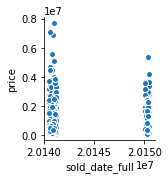

In [8]:
# Sold date versus price - Pairplot visualization
sns.pairplot(house_df_new,x_vars='sold_date_full',y_vars='price')

There are clusters forming up in the time series. Hence, let's split them up into indivdual features - date, month and year

In [9]:
# Creating separate features for sold date,month and year
house_df_new['sold_year']=house_df_new['dayhours'].str[:4].astype('int64')
house_df_new['sold_month']=house_df_new['dayhours'].str[4:6].astype('int64')
house_df_new['sold_date']=house_df_new['dayhours'].str[6:8].astype('int64')

In [10]:
# Evaluating feature - sold_year
house_df_new['sold_year'].head(5)

0    2014
1    2014
2    2015
3    2014
4    2015
Name: sold_year, dtype: int64

In [11]:
# evaluating feature - sold_month
house_df_new['sold_month'].head(5)

0    11
1    12
2     4
3     5
4     4
Name: sold_month, dtype: int64

In [12]:
# evaluating feature- sold_date
house_df_new['sold_date'].head(5)

0     7
1     4
2    20
3    29
4    24
Name: sold_date, dtype: int64

In [13]:
# having split the dayhours data, dropping the dayhours column from the dataframe

house_df_new=house_df_new.drop('dayhours',axis=1)

In [14]:
# looking into the new dataframe after dropping dayhours feature
house_df_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 26 columns):
cid                 21613 non-null int64
price               21613 non-null int64
room_bed            21613 non-null int64
room_bath           21613 non-null float64
living_measure      21613 non-null int64
lot_measure         21613 non-null int64
ceil                21613 non-null float64
coast               21613 non-null int64
sight               21613 non-null int64
condition           21613 non-null int64
quality             21613 non-null int64
ceil_measure        21613 non-null int64
basement            21613 non-null int64
yr_built            21613 non-null int64
yr_renovated        21613 non-null int64
zipcode             21613 non-null int64
lat                 21613 non-null float64
long                21613 non-null float64
living_measure15    21613 non-null int64
lot_measure15       21613 non-null int64
furnished           21613 non-null int64
total_area          21

## Checking for missing values

In [15]:
# Check for NA values and count for each feature
house_df_new.isna().sum(axis=0)

cid                 0
price               0
room_bed            0
room_bath           0
living_measure      0
lot_measure         0
ceil                0
coast               0
sight               0
condition           0
quality             0
ceil_measure        0
basement            0
yr_built            0
yr_renovated        0
zipcode             0
lat                 0
long                0
living_measure15    0
lot_measure15       0
furnished           0
total_area          0
sold_date_full      0
sold_year           0
sold_month          0
sold_date           0
dtype: int64

There are no missing values in the dataset.

## Univariate analysis

Univariate analysis – data types and description of the independent attributes which should include (name, meaning, range of values observed, central values (mean and median), standard deviation and quartiles, analysis of the body of distributions / tails, missing values, outliers

In [16]:
# bird's eye view of the numerical distribution of the dataframe

house_df_new.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
cid,21613.0,4.580302e+09,2.876566e+09,1.000102e+06,2.123049e+09,3.904930e+09,7.308900e+09,9.900000e+09
price,21613.0,5.401822e+05,3.673622e+05,7.500000e+04,3.219500e+05,4.500000e+05,6.450000e+05,7.700000e+06
room_bed,21613.0,3.370842e+00,9.300618e-01,0.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,3.300000e+01
room_bath,21613.0,2.114757e+00,7.701632e-01,0.000000e+00,1.750000e+00,2.250000e+00,2.500000e+00,8.000000e+00
living_measure,21613.0,2.079900e+03,9.184409e+02,2.900000e+02,1.427000e+03,1.910000e+03,2.550000e+03,1.354000e+04
lot_measure,21613.0,1.510697e+04,4.142051e+04,5.200000e+02,5.040000e+03,7.618000e+03,1.068800e+04,1.651359e+06
ceil,21613.0,1.494309e+00,5.399889e-01,1.000000e+00,1.000000e+00,1.500000e+00,2.000000e+00,3.500000e+00
coast,21613.0,7.541757e-03,8.651720e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
sight,21613.0,2.343034e-01,7.663176e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e+00
condition,21613.0,3.409430e+00,6.507430e-01,1.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,5.000000e+00


To get more clarity let's evalaute each variable separately

## Univariate Analysis and Bivariate Analysis

Check the input variable distribution and outliers, Incase of outlier presence, evaluate importance through corelation analysis with target price 


### Variable: CID -> A notation for the house

,cid,price,room_bed,room_bath,living_measure,lot_measure,ceil,coast,sight,condition,...,lat,long,living_measure15,lot_measure15,furnished,total_area,sold_date_full,sold_year,sold_month,sold_date
0,3034200666,808100,4,3.25,3020,13457,1.0,0,0,5,...,47.7174,-122.336,2120,7553,1,16477,20141107,2014,11,7
1,8731981640,277500,4,2.50,2550,7500,1.0,0,0,3,...,47.3165,-122.386,2260,8800,0,10050,20141204,2014,12,4
2,5104530220,404000,3,2.50,2370,4324,2.0,0,0,3,...,47.3515,-121.999,2370,4348,0,6694,20150420,2015,4,20


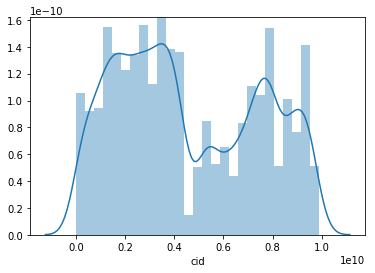

In [17]:
# Verifying the distribution and histogram of the variable

sns.distplot(house_df_new['cid'])
house_df_new.head(3)

#### Inference of distribution

There are two distinct distribution peaks in the column. Though this variable is used just as an identification variable, the histogram shows there are repeat/duplicate entries

In [18]:
# creation of a copy dataframe to evaluate the duplicates

house_df_f=house_df_new.copy()

# duplicate entry extraction

house_df_f['cid_id']=house_df_new['cid'].duplicated()

In [19]:
# size of the duplicate dataframe

house_df_f.loc[house_df_f['cid_id'] == True].shape

(177, 27)

There are a total of 177 duplicate entries in the dataframe. Let's look into the nature of the duplicates and check if they are really duplicates

In [20]:
# Listing the top 5 duplicate entries

house_df_f.loc[house_df_f['cid_id'] == True].sort_values(by='cid').head(5)

,cid,price,room_bed,room_bath,living_measure,lot_measure,ceil,coast,sight,condition,...,long,living_measure15,lot_measure15,furnished,total_area,sold_date_full,sold_year,sold_month,sold_date,cid_id
17038,1000102,280000,6,3.00,2400,9373,2.0,0,0,3,...,-122.214,2060,7316,0,11773,20140916,2014,9,16,True
19995,7200179,150000,2,1.00,840,12750,1.0,0,0,3,...,-122.211,1480,6969,0,13590,20141016,2014,10,16,True
17161,109200390,245000,3,1.75,1480,3900,1.0,0,0,4,...,-122.367,1830,6956,0,5380,20140820,2014,8,20,True
12964,123039336,148000,1,1.00,620,8261,1.0,0,0,3,...,-122.364,1180,8244,0,8881,20140611,2014,6,11,True
8544,251300110,225000,3,2.25,2510,12013,2.0,0,0,3,...,-122.314,1870,8017,0,14523,20140731,2014,7,31,True


In [21]:
# returning all instances of the first 5 duplicate entries

house_df_f.loc[house_df_f['cid'].isin(['1000102','7200179','109200390','123039336','251300110'])].sort_values(by='cid')

,cid,price,room_bed,room_bath,living_measure,lot_measure,ceil,coast,sight,condition,...,long,living_measure15,lot_measure15,furnished,total_area,sold_date_full,sold_year,sold_month,sold_date,cid_id
3405,1000102,300000,6,3.00,2400,9373,2.0,0,0,3,...,-122.214,2060,7316,0,11773,20150422,2015,4,22,False
17038,1000102,280000,6,3.00,2400,9373,2.0,0,0,3,...,-122.214,2060,7316,0,11773,20140916,2014,9,16,True
3874,7200179,175000,2,1.00,840,12750,1.0,0,0,3,...,-122.211,1480,6969,0,13590,20150424,2015,4,24,False
19995,7200179,150000,2,1.00,840,12750,1.0,0,0,3,...,-122.211,1480,6969,0,13590,20141016,2014,10,16,True
1727,109200390,250000,3,1.75,1480,3900,1.0,0,0,4,...,-122.367,1830,6956,0,5380,20141020,2014,10,20,False
17161,109200390,245000,3,1.75,1480,3900,1.0,0,0,4,...,-122.367,1830,6956,0,5380,20140820,2014,8,20,True
8438,123039336,244900,1,1.00,620,8261,1.0,0,0,3,...,-122.364,1180,8244,0,8881,20141208,2014,12,8,False
12964,123039336,148000,1,1.00,620,8261,1.0,0,0,3,...,-122.364,1180,8244,0,8881,20140611,2014,6,11,True
5441,251300110,358000,3,2.25,2510,12013,2.0,0,0,3,...,-122.314,1870,8017,0,14523,20150114,2015,1,14,False
8544,251300110,225000,3,2.25,2510,12013,2.0,0,0,3,...,-122.314,1870,8017,0,14523,20140731,2014,7,31,True


### Inference of duplicates:

There are certain repeated entries indicating the same property has been bought and resold, since there is no change in the other parameters. Hence, we are retaining them in the dataframe.

In [22]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['cid'],name='House property identifier',showlegend=True))]
plotly.offline.iplot(data,image='jpeg')


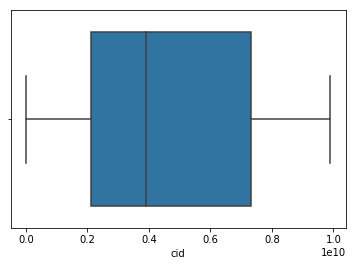

In [23]:
sns.boxplot(house_df_new['cid'])
plt.show()

In [24]:
# corelation of cid vs price
house_df_new['cid'].corr(house_df_new['price'])

-0.016797345163422024

### Inference of outliers

No outliers present in this variable. 

Note: This is an identification variable only, also implicated by no corelation with price, hence, this variable can be dropped for regression analysis.

## Variable room_bed -> No. of bedrooms/home

In [25]:
#evaluating the unique entries in the variable list

house_df_new['room_bed'].sort_values().unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 33], dtype=int64)

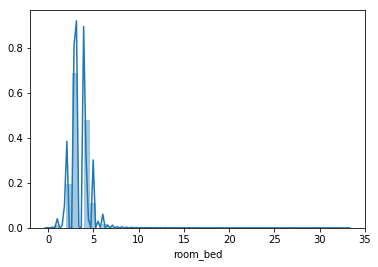

In [26]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['room_bed'])
plt.show()

### Inference of distribution

The data is right skewed indicating outliers, and also there are distinct peaks indicating clusters present in the dataframe

In [27]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['room_bed'],name='room_bed',showlegend=True))]
plotly.offline.iplot(data)


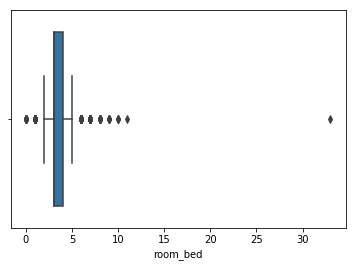

In [28]:
sns.boxplot(house_df_new['room_bed'])
plt.show()

### Inference of outliers

The no. of rooms vary from 0 to 33. 

The outliers are present below 2 and above 5 as per the box plot. Outliers treatment is required here.

In [29]:
# Evaluating the outliers in number of bedrooms - Case A 

# case A

room_bed_outlier=house_df_new[(house_df_new.room_bed>5)|(house_df_new.room_bed<2)]
room_bed_outlier.shape

(546, 26)

In [30]:
# Case A corelation with price
room_bed_outlier['room_bed'].corr(house_df_new['price'])

0.34516796834918345

There are 546 entries with no. of bedrooms >5 and <2. It has a very low corelation with price. Let's check the number of entries with no. of bedrooms >5 and <1.

In [31]:
# Case B

room_bed_outlier_1=house_df_new[(house_df_new.room_bed>5)|(house_df_new.room_bed<1)]
room_bed_outlier_1.shape

(347, 26)

In [32]:
# Case B corelation with price
room_bed_outlier_1['room_bed'].corr(house_df_new['price'])

0.07117047300043448

There are 347 entries with no. of bedrooms >5 and <1. It has no corelation with price. Hence, we can remove them from the analysis dataframe. If more improvement to model accuracy is required, then Case A can be removed.

## Variable room_bath -> No. of bathrooms/bedroom

In [33]:
#evaluating the unique entries in the variable list

house_df_new['room_bath'].sort_values().unique()

array([0.  , 0.5 , 0.75, 1.  , 1.25, 1.5 , 1.75, 2.  , 2.25, 2.5 , 2.75,
       3.  , 3.25, 3.5 , 3.75, 4.  , 4.25, 4.5 , 4.75, 5.  , 5.25, 5.5 ,
       5.75, 6.  , 6.25, 6.5 , 6.75, 7.5 , 7.75, 8.  ])

In [34]:
# evaluating the number of unique entries
house_df_new['room_bath'].sort_values().unique().shape

(30,)

The no. of room_bath vary from 0 to 8 with a total of 30 unique entries and there are decimal values too. 

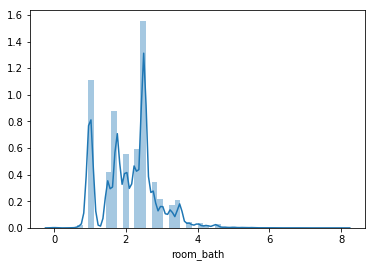

In [35]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['room_bath'])
plt.show()

### Inference of distribution

The data is right skewed indicating outliers, and also there are distinct peaks indicating clusters present in the dataframe

In [36]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['room_bath'],name='room_bath',showlegend=True))]
plotly.offline.iplot(data)

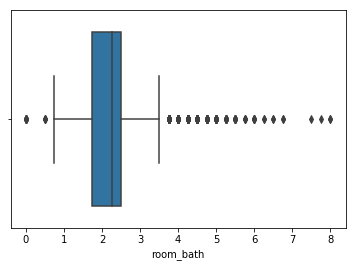

In [37]:
sns.boxplot(house_df_new['room_bath'])
plt.show()

### Inference of suspected outliers

The outliers are present below 0.75 and above 3.5 as per the box plot. Outliers treatment is required here.

In [38]:
# creating outlier dataframe
room_bath_outlier=house_df_new[(house_df_new.room_bath>3.5)|(house_df_new.room_bath<0.75)]
room_bath_outlier.shape

(571, 26)

In [39]:
# corelation of no. of bathrooms/bedrooms with price
room_bath_outlier['room_bath'].corr(house_df_new['price'])

0.3971666095400386

There are 571 outlier entries and have moderate positive corelation only with price. Hence based on modelling accuracy we can decide if to retain or remove the outliers.

## Variable living_measure -> square footage of the home

In [40]:
#evaluating the unique entries in the variable list

house_df_new['living_measure'].sort_values().unique()

array([  290,   370,   380, ..., 10040, 12050, 13540], dtype=int64)

In [41]:
# evaluating the number of unique entries
house_df_new['living_measure'].sort_values().unique().shape

(1038,)

There are 1038 unique entries of living measure

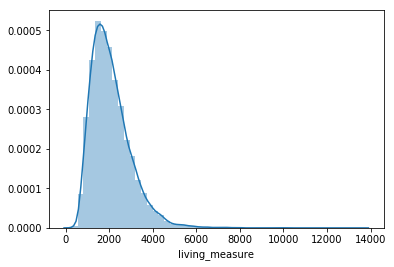

In [42]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['living_measure'])
plt.show()

### Inference of distribution

The data is normally distributed and it is right skewed indicating outliers.

In [43]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['living_measure'],name='living_measure',showlegend=True))]
plotly.offline.iplot(data)

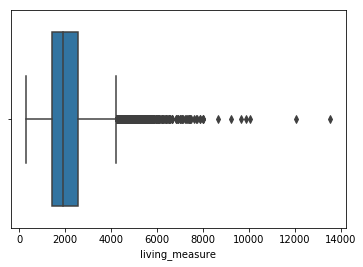

In [44]:
sns.boxplot(house_df_new['living_measure'])
plt.show()

### Inference of suspected outliers

The outliers are present above 4230 as per the box plot.

In [45]:
# creating outlier dataframe
living_measure_outlier=house_df_new[(house_df_new.living_measure>4230)]
living_measure_outlier.shape

(572, 26)

In [46]:
# corelation of living measure with price
living_measure_outlier['living_measure'].corr(house_df_new['price'])

0.5313679078718592

There are 572 outlier entries. Also they have moderate postivie corelation with price. Hence, decision to remove or retain need to be taken based on model accuracy.

## Variable lot_measure -> square footage of the lot

In [47]:
#evaluating the unique entries in the variable list

house_df_new['lot_measure'].sort_values().unique()

array([    520,     572,     600, ..., 1074218, 1164794, 1651359],
      dtype=int64)

In [48]:
# evaluating the number of unique entries
house_df_new['lot_measure'].sort_values().unique().shape

(9782,)

There are 9782 unique entries of lot measure

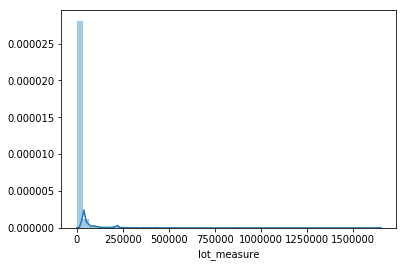

In [49]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['lot_measure'])
plt.show()

### Inference of distribution

The data is normally distributed and it is right skewed indicating outliers. The histogram shows an abnormaly high number of instances in the lot measures of smaller size, indicating maximum presence of such properties.

In [50]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['lot_measure'],name='lot_measure',showlegend=True))]
plotly.offline.iplot(data)

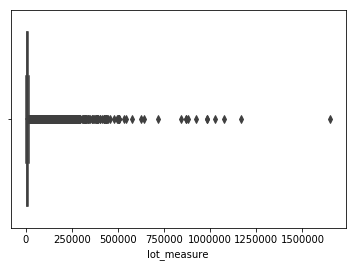

In [51]:
sns.boxplot(house_df_new['lot_measure'])
plt.show()

### Inference of suspected outliers

The outliers are present above 19141 as per the box plot.

In [52]:
# creating outlier dataframe
lot_measure_outlier=house_df_new[(house_df_new.lot_measure>19141)]
lot_measure_outlier.shape

(2425, 26)

In [53]:
# corelation of lot measure with price
lot_measure_outlier['lot_measure'].corr(house_df_new['price'])

-0.02223003352034574

There are 2425 outlier entries. They have no corelation with price. Hence, they can be removed from the analysis dataframe.

## Variable ceil -> Total floors in the house

In [54]:
#evaluating the unique entries in the variable list

house_df_new['ceil'].sort_values().unique()

array([1. , 1.5, 2. , 2.5, 3. , 3.5])

In [55]:
# evaluating the number of unique entries
house_df_new['ceil'].sort_values().unique().shape

(6,)

There are 6 unique entries of total floors in house. There are decimal entries too. 

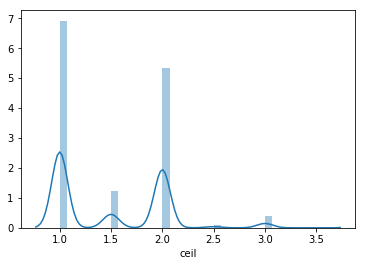

In [56]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['ceil'])
plt.show()

### Inference of distribution

The data has 4 peaks indicating 4 clusters. Maximum occurance in the histogram is 1 floor followed by 2 floors. The data is right skewed indicating outliers in the higher no.of floors.

In [57]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['ceil'],name='ceil',showlegend=True))]
plotly.offline.iplot(data)

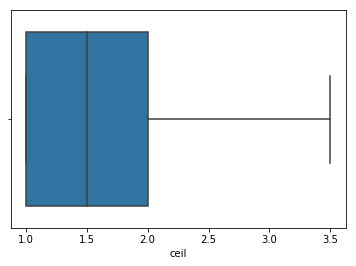

In [58]:
sns.boxplot(house_df_new['ceil'])
plt.show()

### Inference of suspected outliers

Contrary to the inference of distribution plot, there are no outliers in the no. of floors in box plot. Hence, no outlier treatment required.

## Variable coast -> If the property is near a waterbody

In [59]:
#evaluating the unique entries in the variable list

house_df_new['coast'].sort_values().unique()

array([0, 1], dtype=int64)

In [60]:
# evaluating the number of unique entries
house_df_new['coast'].sort_values().unique().shape

(2,)

This variable is of categorical type indicating if the property is facing a waterbody or not.

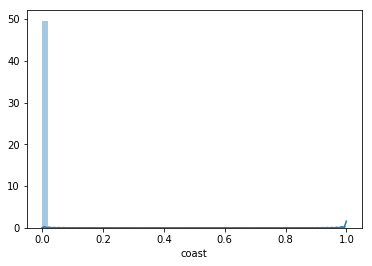

In [61]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['coast'])
plt.show()

### Inference of distribution

The data is extremely right skewed. The histogram shows an abnormaly high number of instances of the properties without facing a waterbody.

In [62]:
# Number of houses not facing waterbody
coast_no=house_df_new[house_df_new.coast==0].shape
coast_no[0]

21450

In [63]:
# Number of houses facing waterbody
coast_yes=house_df_new[house_df_new.coast==1].shape
coast_yes[0]

163

In [64]:
# Percentage of houses facing waterbody
print ('%3.2f'%(coast_yes[0]/df_size[0]*100),'%')

0.75 %


The data shows only 163 houses are facing a waterbody, while the remaining is not. That is only 0.75% of the total houses are facing the waterbody.

In [65]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['furnished'],name='Furnished',showlegend=True))]
plotly.offline.iplot(data)

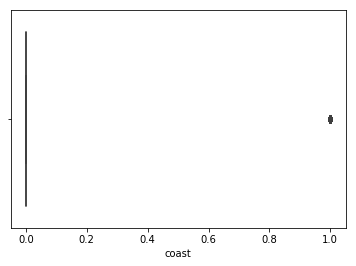

In [66]:
sns.boxplot(house_df_new['coast'])
plt.show()

### Inference of Suspected outliers

As the number of houses facing waterbody are only 0.75% of the total population in the database, they have been marked as outliers. Hence, let's evaluate the impact of facing waterbody against the price.

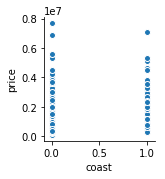

In [67]:
# Waterbody facing status versus price - Pairplot visualization
sns.pairplot(house_df_new,x_vars='coast',y_vars='price')

In [68]:
# Furnished status versus price - Correlation analysis
house_df_new['coast'].corr(house_df_new['price'])

0.26633051052225637

The variable furnished has a low corelation with the target price. Also, as the population of this sample is low, we can remove them from analysis.

In [69]:
# creating outlier dataframe
coast_outlier=house_df_new[(house_df_new.coast==1)]
coast_outlier.shape

(163, 26)

## Variable sight -> If the property has been viewed

In [70]:
#evaluating the unique entries in the variable list

house_df_new['sight'].sort_values().unique()

array([0, 1, 2, 3, 4], dtype=int64)

In [71]:
# evaluating the number of unique entries
house_df_new['sight'].sort_values().unique().shape

(5,)

This variable is of categorical type indicating how many times the property has been viewed. 0 indicates the property has not been viewed earlier, while maximum number of views is 4.

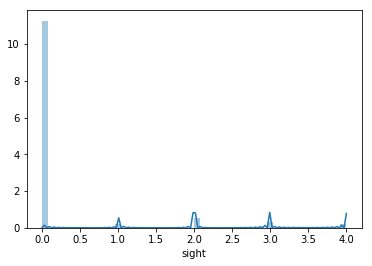

In [72]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['sight'])
plt.show()

### Inference of distribution

The data is extremely right skewed. The histogram shows an abnormaly high number of instances of the properties without previous viewings.

In [73]:
# Number of houses not viewed previously : Case C0
sight_no=house_df_new[house_df_new.sight==0].shape
sight_no[0]

19489

In [74]:
# Number of houses previously viewed once : Case C1
sight_once=house_df_new[house_df_new.sight==1].shape
sight_once[0]

332

In [75]:
# Number of houses previously viewed twice : Case C2
sight_twice=house_df_new[house_df_new.sight==2].shape
sight_twice[0]

963

In [76]:
# Number of houses previously viewed thrice : Case C3
sight_thrice=house_df_new[house_df_new.sight==3].shape
sight_thrice[0]

510

In [77]:
# Number of houses previously viewed fourtimes : Case C4
sight_four=house_df_new[house_df_new.sight==4].shape
sight_four[0]

319

In [78]:
# No. of houses viewed previously
print (sight_once[0]+sight_twice[0]+sight_thrice[0]+sight_four[0])

2124


In [79]:
# Percentage of houses viewed previously
print ('%3.2f'%((sight_once[0]+sight_twice[0]+sight_thrice[0]+sight_four[0])/df_size[0]*100),'%')

9.83 %


The data shows only 2164 houses were viewed previously accounting for 9.83% of the total house population.This is a signifant number. Hence, the impact of pricing needs to be evaulated for decision on outlier treatment.

In [80]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['sight'],name='sight',showlegend=True))]
plotly.offline.iplot(data)

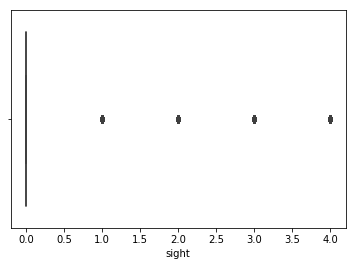

In [81]:
sns.boxplot(house_df_new['sight'])
plt.show()

### Inference of Suspected outliers

As the number of houses viewed previously are only 9.83% of the total population in the database, they have been marked as outliers. Hence, let's evaluate the impact of property viewed previously against the price.

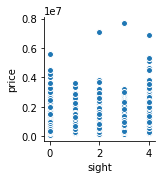

In [82]:
# House previously viewed status versus price - Pairplot visualization
sns.pairplot(house_df_new,x_vars='sight',y_vars='price')

In [83]:
# House previously viewed status versus price - Correlation analysis
house_df_new['sight'].corr(house_df_new['price'])

0.3973464743789392

The variable furnished has a low corelation with the target price. However, the call to remove or retain them can be taken based on modelling accuracy since they the number of entities are of sizeable number

In [84]:
# creating outlier dataframe
sight_outlier=house_df_new[(house_df_new.sight>0)]
sight_outlier.shape

(2124, 26)

## Variable condition -> How good the condition is (Overall)

In [85]:
#evaluating the unique entries in the variable list

house_df_new['condition'].sort_values().unique()

array([1, 2, 3, 4, 5], dtype=int64)

In [86]:
# evaluating the number of unique entries
house_df_new['condition'].sort_values().unique().shape

(5,)

This variable is of categorical type indicating the overall condition of the property with value ranging from 1 to 5. Probably 1 indicating poor condition and 5 indicating very good condition.  

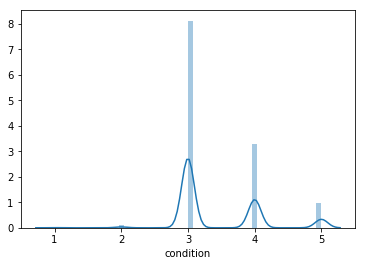

In [87]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['condition'])
plt.show()

### Inference of distribution

The data has three peaks. With the mean rating of 3 the maximum number of the occurances, the distribution is centrally spread. 

In [88]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['condition'],name='condition',showlegend=True))]
plotly.offline.iplot(data)

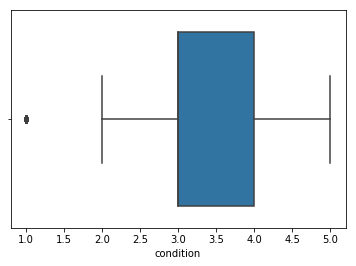

In [89]:
sns.boxplot(house_df_new['condition'])
plt.show()

### Inference of Suspected outliers

The boxplot shows that the condition 1 is an outlier. Let's quantify the number of instances of condition 1.

In [90]:
# creating outlier dataframe
condition_outlier=house_df_new[(house_df_new.condition==1)]
condition_outlier.shape

(30, 26)

There are only 30 outlier entitites. Let us remove them from the analysis dataframe.

## Variable quality -> grade given to the housing unit, based on grading system

In [91]:
#evaluating the unique entries in the variable list

house_df_new['quality'].sort_values().unique()

array([ 1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13], dtype=int64)

In [92]:
# evaluating the number of unique entries
house_df_new['quality'].sort_values().unique().shape

(12,)

This variable is of categorical type indicating the grade of the property with value ranging from 1 to 13. 

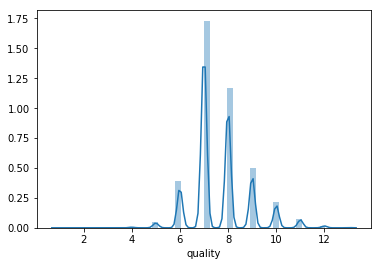

In [93]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['quality'])
plt.show()

### Inference of distribution

The data has 7 peaks. With the mean rating of 7 the maximum number of the occurances, the distribution is centrally spread. 

In [94]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['quality'],name='quality',showlegend=True))]
plotly.offline.iplot(data)

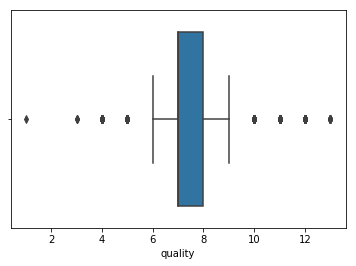

In [95]:
sns.boxplot(house_df_new['quality'])
plt.show()

### Inference of Suspected outliers

The boxplot shows that the quality <6 and >9 are outliers. Let's quantify the number outlier instances.

In [96]:
# creating outlier dataframe
quality_outlier=house_df_new[(house_df_new.quality<6)|(house_df_new.quality>9)]
quality_outlier.shape

(1911, 26)

There are 1911 outlier entitites. Let us look into the respective corelation with price.

In [97]:
# correlation of quality with price
quality_outlier['quality'].corr(house_df_new['price'])

0.5804696076433611

The outlier variables have a moderate positive corelation with price. Hence, based on model accuracy the decision to remove or retain the outliers can be made

## Variable ceil_measure -> square footage apart from basement

In [98]:
# evaluating the number of unique entries
house_df_new['ceil_measure'].sort_values().unique().shape

(946,)

There are 946 unique entries in the variable

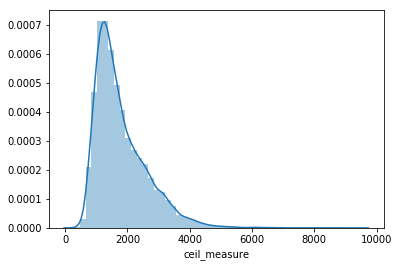

In [99]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['ceil_measure'])
plt.show()

### Inference of distribution

The data is normally distributed with moderate right skewedness indicating presence of outliers in high ceil measures.

In [100]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['ceil_measure'],name='ceil_measure',showlegend=True))]
plotly.offline.iplot(data)

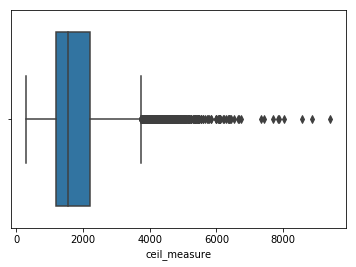

In [101]:
sns.boxplot(house_df_new['ceil_measure'])
plt.show()

### Inference of Suspected outliers

The boxplot shows that ceil measure > 3740 are outliers. Let's quantify the number of instances.

In [102]:
# creating outlier dataframe
ceil_measure_outlier=house_df_new[(house_df_new.ceil_measure>3740)]
ceil_measure_outlier.shape

(611, 26)

In [103]:
# corelation of ceil_measure with price

ceil_measure_outlier['ceil_measure'].corr(house_df_new['price'])

0.5225527924264771

There are 611 outlier entitites and they have moderate positive corelation with price. Hence, based on model accuracy we can choose to remove or retain them.

## Variable basement -> square footage of basement

In [104]:
#evaluating the unique entries in the variable list

house_df_new['basement'].sort_values().unique()

array([   0,   10,   20,   40,   50,   60,   65,   70,   80,   90,  100,
        110,  120,  130,  140,  143,  145,  150,  160,  170,  172,  176,
        180,  190,  200,  207,  210,  220,  225,  230,  235,  240,  243,
        248,  250,  260,  265,  266,  270,  274,  276,  280,  283,  290,
        295,  300,  310,  320,  330,  340,  350,  360,  370,  374,  380,
        390,  400,  410,  414,  415,  417,  420,  430,  435,  440,  450,
        460,  470,  475,  480,  490,  500,  506,  508,  510,  515,  516,
        518,  520,  530,  540,  550,  556,  560,  570,  580,  588,  590,
        600,  602,  610,  620,  630,  640,  650,  652,  660,  666,  670,
        680,  690,  700,  704,  710,  720,  730,  740,  750,  760,  768,
        770,  780,  784,  790,  792,  800,  810,  820,  830,  840,  850,
        860,  861,  862,  870,  875,  880,  890,  894,  900,  906,  910,
        915,  920,  930,  935,  940,  946,  950,  960,  970,  980,  990,
       1000, 1008, 1010, 1020, 1024, 1030, 1040, 10

In [105]:
# evaluating the number of unique entries
house_df_new['basement'].sort_values().unique().shape

(306,)

There are 306 unique entries in the variable

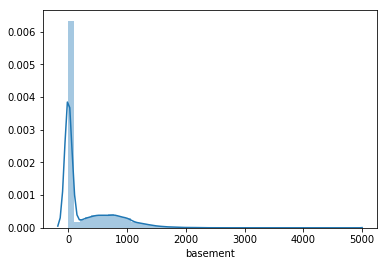

In [106]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['basement'])
plt.show()

### Inference of distribution

The data has two peaksright skewedness indicating presence of outliers in high basement measures. Also histogram indicates that most of the houses do not have basement.

In [107]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['basement'],name='basement',showlegend=True))]
plotly.offline.iplot(data)

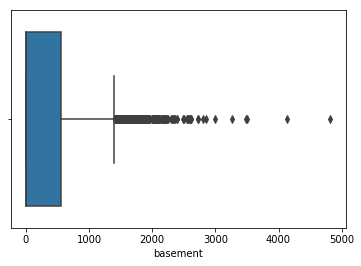

In [108]:
sns.boxplot(house_df_new['basement'])
plt.show()

### Inference of Suspected outliers

The boxplot shows that basement measures > 1400 are outliers. Let's quantify the number of instances.

In [109]:
# creating outlier dataframe
basement_outlier=house_df_new[(house_df_new.basement>1400)]
basement_outlier.shape

(496, 26)

In [110]:
# corelation of basement size with price

basement_outlier['basement'].corr(house_df_new['price'])

0.43521614552326165

There are 496 outlier entitites and they have a moderate positive corelation with price. Hence, based on modelling accuracy let's take a call to remove or retain them.

## Variable yr_built-> Built year

In [111]:
#evaluating the unique entries in the variable list

house_df_new['yr_built'].sort_values().unique()

array([1900, 1901, 1902, 1903, 1904, 1905, 1906, 1907, 1908, 1909, 1910,
       1911, 1912, 1913, 1914, 1915, 1916, 1917, 1918, 1919, 1920, 1921,
       1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932,
       1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943,
       1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954,
       1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965,
       1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976,
       1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987,
       1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998,
       1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009,
       2010, 2011, 2012, 2013, 2014, 2015], dtype=int64)

In [112]:
# evaluating the number of unique entries
house_df_new['yr_built'].sort_values().unique().shape

(116,)

There are 116 unique entries in the variable. The earliest built house is in 1900 while the latest being built in 2015.

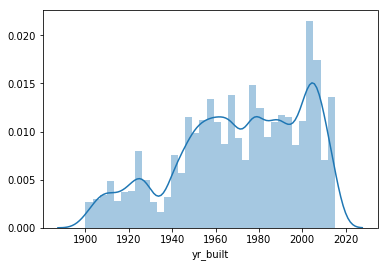

In [113]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['yr_built'])
plt.show()

### Inference of distribution

The data shows that the houses being built were following an increase in trend from 1900 and peaking in the 2000s. 

In [114]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['yr_built'],name='yr_built',showlegend=True))]
plotly.offline.iplot(data)

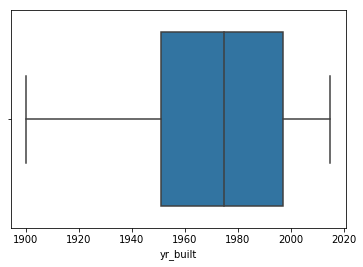

In [115]:
sns.boxplot(house_df_new['yr_built'])
plt.show()

### Inference of Suspected outliers

The boxplot shows there are no outliers in the data.

## Variable yr_renovated -> Renovated year

In [116]:
#evaluating the unique entries in the variable list

house_df_new['yr_renovated'].sort_values().unique()

array([   0, 1934, 1940, 1944, 1945, 1946, 1948, 1950, 1951, 1953, 1954,
       1955, 1956, 1957, 1958, 1959, 1960, 1962, 1963, 1964, 1965, 1967,
       1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978,
       1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989,
       1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000,
       2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015], dtype=int64)

In [117]:
# evaluating the number of unique entries
house_df_new['yr_renovated'].sort_values().unique().shape

(70,)

There are 70 unique entries in the variable. '0' would be typically refering that the property was not renovated.

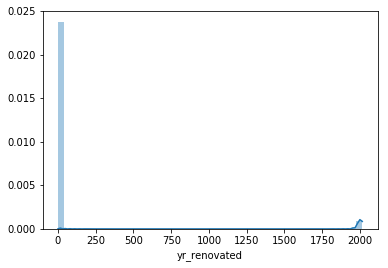

In [118]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['yr_renovated'])
plt.show()

### Inference of distribution

The data has two inferences. One being that most of the houses are not renovated. The second being that the renovations followed were mostly in the 2000s.

In [119]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['yr_renovated'],name='yr_renovated',showlegend=True))]
plotly.offline.iplot(data)

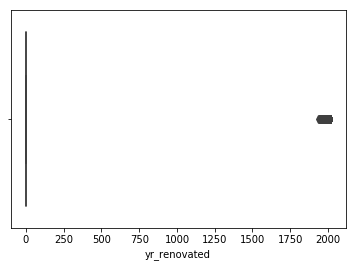

In [120]:
sns.boxplot(house_df_new['yr_renovated'])
plt.show()

### Inference of Suspected outliers

The boxplot shows that all the renovations being an outlier. Let's look into the number of such instances.

In [121]:
# creating outlier dataframe
yr_renovated_outlier=house_df_new[(house_df_new.yr_renovated>0)]
yr_renovated_outlier.shape

(914, 26)

There are 914 outlier entitites. Let us look into its corelation with price to decide on whether to remove them or not from the analysis dataframe.

In [122]:
# corelation of yr_renovated with price
yr_renovated_outlier['yr_renovated'].corr(house_df_new['price'])

0.12792638428182113

The corelation with price is very low. Hence, we can remove them from the analysis dataframe

## Variable zipcode -> Property Zipcode

In [123]:
#evaluating the unique entries in the variable list

house_df_new['zipcode'].sort_values().unique()

array([98001, 98002, 98003, 98004, 98005, 98006, 98007, 98008, 98010,
       98011, 98014, 98019, 98022, 98023, 98024, 98027, 98028, 98029,
       98030, 98031, 98032, 98033, 98034, 98038, 98039, 98040, 98042,
       98045, 98052, 98053, 98055, 98056, 98058, 98059, 98065, 98070,
       98072, 98074, 98075, 98077, 98092, 98102, 98103, 98105, 98106,
       98107, 98108, 98109, 98112, 98115, 98116, 98117, 98118, 98119,
       98122, 98125, 98126, 98133, 98136, 98144, 98146, 98148, 98155,
       98166, 98168, 98177, 98178, 98188, 98198, 98199], dtype=int64)

In [124]:
# evaluating the number of unique entries
house_df_new['zipcode'].sort_values().unique().shape

(70,)

There are 70 unique zipcode entries in the dataset. On looking up the zipcodes, these are located in Seattle, Washington in the USA.

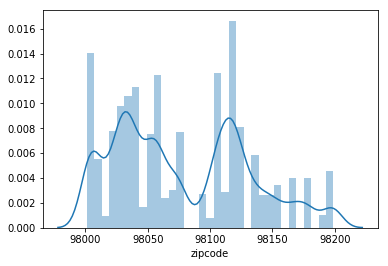

In [125]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['zipcode'])
plt.show()

### Inference of distribution

There are multiple peaks indicating clusters present in the data. Almost all zipcodes have multiple entries, indicating multiple house properties in a given area. 

In [126]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['zipcode'],name='zipcode',showlegend=True))]
plotly.offline.iplot(data)

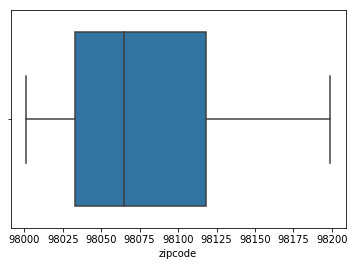

In [127]:
sns.boxplot(house_df_new['zipcode'])
plt.show()

### Inference of outliers

There are no outliers present in the dataset.

## Variable lat -> Property latitude

In [128]:
#evaluating the unique entries in the variable list

house_df_new['lat'].sort_values().unique()

array([47.1559, 47.1593, 47.1622, ..., 47.7774, 47.7775, 47.7776])

In [129]:
# evaluating the number of unique entries
house_df_new['lat'].sort_values().unique().shape

(5034,)

There are 5034 unique latitude entries in the dataset. 

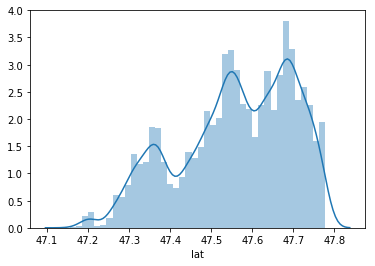

In [130]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['lat'])
plt.show()

### Inference of distribution

There are three distinct peaks indicating 3 prominent latitude clusters present in the data. 

In [131]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['lat'],name='lat',showlegend=True))]
plotly.offline.iplot(data)

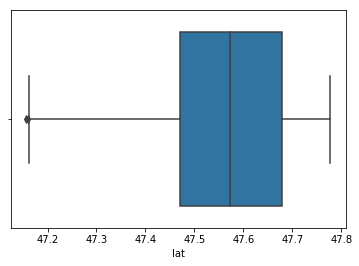

In [132]:
sns.boxplot(house_df_new['lat'])
plt.show()

### Inference of suspected outliers

As per boxplot, latitudes < 47.1622 are outliers. And thus there are two outliers present in the dataset. Let's us look in conjection with longitude details to check if they are truly outliers.

## Suspected Outlier Verification - Latitude

In [133]:
# printing all rows with suspected outliers in Latitude and checking against longitude and zipcode

house_df_new[house_df_new.lat<47.1622][['lat','long','zipcode']]

,lat,long,zipcode
2815,47.1559,-121.646,98022
8186,47.1593,-121.957,98022


### Outlier Conclusion

The suspected latitude coordinates were verified along with the respective longitudes and were matching to the zipcode provided. Hence, they are not cases of mis-entry and thus these data points would be retained in the dataset.

#### Online verification of co-ordinates

https://www.melissa.com/v2/lookups/latlngzip4/index?lat=47.1559&lng=-121.646

https://www.melissa.com/v2/lookups/latlngzip4/index?lat=47.1593&lng=-121.957

## Variable long -> Property longitude

In [134]:
#evaluating the unique entries in the variable list

house_df_new['long'].sort_values().unique()

array([-122.519, -122.515, -122.514, -122.512, -122.511, -122.509,
       -122.507, -122.506, -122.505, -122.504, -122.503, -122.502,
       -122.499, -122.497, -122.496, -122.491, -122.49 , -122.486,
       -122.484, -122.482, -122.479, -122.475, -122.474, -122.473,
       -122.472, -122.47 , -122.469, -122.467, -122.465, -122.464,
       -122.463, -122.462, -122.461, -122.46 , -122.459, -122.458,
       -122.457, -122.456, -122.455, -122.454, -122.453, -122.452,
       -122.451, -122.45 , -122.449, -122.448, -122.447, -122.446,
       -122.445, -122.444, -122.443, -122.441, -122.44 , -122.439,
       -122.438, -122.435, -122.433, -122.432, -122.431, -122.43 ,
       -122.425, -122.422, -122.421, -122.42 , -122.416, -122.415,
       -122.414, -122.413, -122.412, -122.411, -122.41 , -122.409,
       -122.408, -122.407, -122.406, -122.405, -122.404, -122.403,
       -122.402, -122.401, -122.4  , -122.399, -122.398, -122.397,
       -122.396, -122.395, -122.394, -122.393, -122.392, -122.

In [135]:
# evaluating the number of unique entries
house_df_new['long'].sort_values().unique().shape

(752,)

There are 752 unique longitude entries in the dataset. 

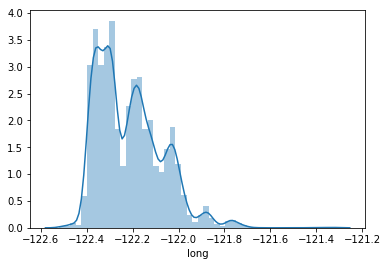

In [136]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['long'])
plt.show()

### Inference of distribution

There are five distinct peaks indicating 5 prominent longitude clusters present in the data. 

In [137]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['long'],name='long',showlegend=True))]
plotly.offline.iplot(data)

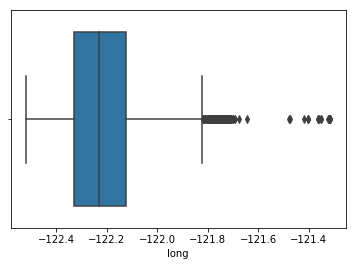

In [138]:
sns.boxplot(house_df_new['long'])
plt.show()

### Inference of suspected outliers

As per boxplot, all values greater that -121.821 are marked as outliers. Let's evaluate them along with latitude to check if they are truly outliers.

## Suspected Outlier Verification - Latitude

In [139]:
# printing all rows with suspected outliers in Latitude and checking against longitude and zipcode

long_outlier=house_df_new[house_df_new.long>-121.821]

long_outlier.shape

(256, 26)

There are a total of 256 suspected outliers in longitude

In [140]:
# verifying unique pincodes of the suspected longitude outliers

long_outlier['zipcode'].unique()

array([98045, 98019, 98065, 98014, 98022], dtype=int64)

### Evaluating one such coordinate in the uszipcode database to check the correctness of the longitude

ID: 21514 Lat: 47.4834 Long: -121.773 Zipcode: 98045

In [141]:
#!pip install uszipcode  #to install the uszipcode package

In [142]:
# using the SearchEngine module in the uszipcode package

from uszipcode import SearchEngine 
search = SearchEngine(simple_zipcode=True) #import only simple_zipcode package (9mb)

In [143]:
# Employing reverse Geocoding to evaluate the zipcode for the input lat and long
res=search.by_coordinates(47.4834,-121.773,radius=10,returns=0)
for i in range(len(res)):
    print(res[i].zipcode)

98024
98065
98038
98014


In [144]:
# corelation of longitude with price

long_outlier['long'].corr(house_df_new['price'])

-0.1715302115557192

### Outlier inference

For this lat and long, the zipcode in the US database is not matching with the entries in our house database. Also, there is no correlation with price, hence, we'll remove them from the analysis dataframe.


## Variable living_measure15 -> If living measure in 2015 (denotes some renovations)

In [145]:
#evaluating the unique entries in the variable list

house_df_new['living_measure15'].sort_values().unique()

array([ 399,  460,  620,  670,  690,  700,  710,  720,  740,  750,  760,
        770,  780,  790,  800,  806,  810,  820,  828,  830,  840,  850,
        860,  870,  880,  890,  900,  910,  920,  930,  940,  950,  952,
        960,  970,  980,  990,  998, 1000, 1010, 1020, 1030, 1040, 1050,
       1056, 1060, 1070, 1076, 1078, 1080, 1084, 1088, 1090, 1092, 1098,
       1100, 1110, 1120, 1125, 1128, 1130, 1131, 1132, 1137, 1138, 1140,
       1150, 1156, 1160, 1162, 1168, 1170, 1175, 1180, 1188, 1190, 1200,
       1210, 1216, 1217, 1220, 1228, 1230, 1232, 1240, 1250, 1256, 1260,
       1264, 1268, 1270, 1277, 1280, 1282, 1285, 1290, 1295, 1300, 1302,
       1303, 1304, 1307, 1309, 1310, 1320, 1321, 1326, 1330, 1336, 1340,
       1346, 1350, 1352, 1356, 1357, 1358, 1360, 1364, 1365, 1369, 1370,
       1377, 1380, 1381, 1390, 1398, 1399, 1400, 1404, 1405, 1408, 1410,
       1414, 1415, 1420, 1425, 1427, 1429, 1430, 1439, 1440, 1442, 1443,
       1445, 1448, 1450, 1458, 1459, 1460, 1463, 14

In [146]:
# evaluating the number of unique entries
house_df_new['living_measure15'].sort_values().unique().shape

(777,)

There are 777 unique renovated living measure entries in the dataset.

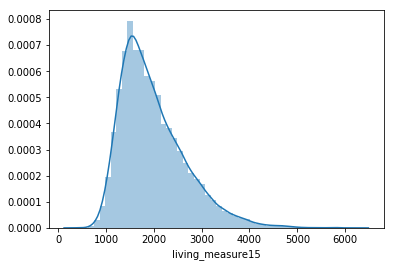

In [147]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['living_measure15'])
plt.show()

### Inference of distribution

The data has a normal distribution with only one peak. The distribution is slightly right skewed, indicating a possibility of outliers.

In [148]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['living_measure15'],name='Living measure renovated in 2015',showlegend=True))]
plotly.offline.iplot(data)

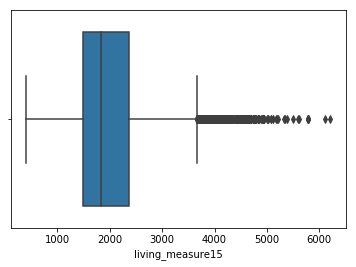

In [149]:
sns.boxplot(house_df_new['living_measure15'])
plt.show()

### Inference of Suspected outliers

As per boxplot, values > 3660 suggests suspected outliers.

In [150]:
# creating outlier dataframe
liv_meas15_outlier=house_df_new[(house_df_new.living_measure15>3660)]
liv_meas15_outlier.shape

(544, 26)

In [151]:
# correlation of living measure (2015) with price

liv_meas15_outlier['living_measure15'].corr(house_df_new['price'])

0.16931321625308454

There are 544 outlier entries. They have no corelation with price. Hence, they can be removed from the analysis dataframe

## Variable lot_measure15 -> Lot measure in 2015 

In [152]:
#evaluating the unique entries in the variable list

house_df_new['lot_measure15'].sort_values().unique()

array([   651,    659,    660, ..., 560617, 858132, 871200], dtype=int64)

In [153]:
# evaluating the number of unique entries
house_df_new['lot_measure15'].sort_values().unique().shape

(8689,)

There are 8689 unique renovated lot measure entries in the dataset.

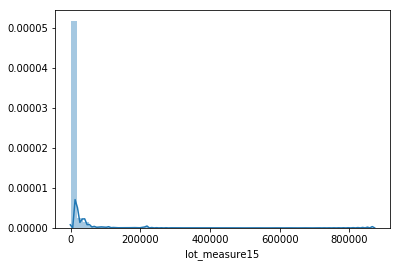

In [154]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['lot_measure15'])
plt.show()

### Inference of distribution

The data has two peaks indicating two clusters. The histogram shows an abnormaly high number of instances in the lot measures of smaller size, indicating maximum presence of such properties. Also, the data is extremely right skewed indicating presence of outliers.

In [155]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['lot_measure15'],name='Lot measure in 2015',showlegend=True))]
plotly.offline.iplot(data)

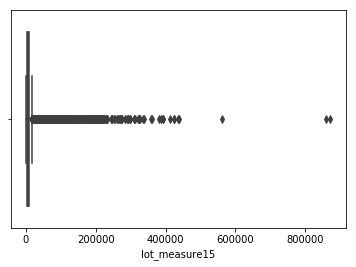

In [156]:
sns.boxplot(house_df_new['lot_measure15'])
plt.show()

### Inference of Suspected outliers

As per boxplot, values > 17.55k suggests suspected outliers.

In [157]:
# creating outlier dataframe
lot_meas15_outlier=house_df_new[(house_df_new.lot_measure15>17550)]
lot_meas15_outlier.shape

(2194, 26)

In [158]:
# correlation of lot measure(2015) with price

lot_meas15_outlier['lot_measure15'].corr(house_df_new['price'])

-0.0863866967458371

There are 2194 outlier entries. And they have no corelation with price. Hene, they can be removed from the analysis dataframe.

## Variable Furnished -> Based on the quality of room 

In [159]:
#evaluating the unique entries in the variable list

house_df_new['furnished'].sort_values().unique()

array([0, 1], dtype=int64)

In [160]:
# evaluating the number of unique entries
house_df_new['furnished'].sort_values().unique().shape

(2,)

This variable is a categorical variable indicating if the room has been furnished or not

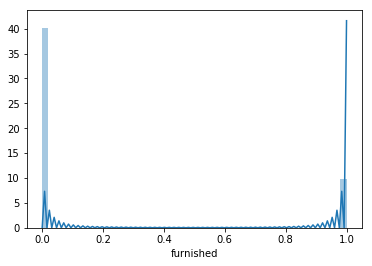

In [161]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['furnished'])
plt.show()

### Inference of distribution

As the data is categorical, distribution cannot be quanitfied. But based on the histogram, we can see that only a few entities are furnished, while the rest are unfurnished.

In [162]:
# Number of unfurnished houses
furn_no=house_df_new[house_df_new.furnished==0].shape
furn_no[0]

17362

In [163]:
# Number of furnished houses
furn_yes=house_df_new[house_df_new.furnished==1].shape
furn_yes[0]

4251

In [164]:
# Percentage of Furnished houses
print ('%3.2f'%(furn_yes[0]/df_size[0]*100),'%')

19.67 %


The data shows only 4251 houses are furnished, while the remaining is unfurnished. That is only 19.67% of the houses are furnished.

In [165]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['furnished'],name='Furnished',showlegend=True))]
plotly.offline.iplot(data)

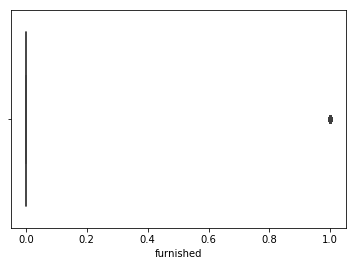

In [166]:
sns.boxplot(house_df_new['furnished'])
plt.show()

### Inference of Suspected outliers

As the number of furnished houses are only 19.67 % of the total population in the database, they have been marked as outliers. Hence, let's evaluate the impact of furnishing against the price.

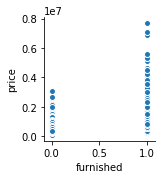

In [167]:
# Furnished status versus price - Pairplot visualization
sns.pairplot(house_df_new,x_vars='furnished',y_vars='price')

In [168]:
# Furnished status versus price - Correlation analysis
house_df_new['furnished'].corr(house_df_new['price'])

0.5659906587421147

The variable furnished has a moderate positive corelation with the target price. Also, in the pairplot it can be seen that the furnished houses have a higher price. Hence, we would retain all the rows.


## Variable total_area -> Measure of both living and lot

In [169]:
#evaluating the unique entries in the variable list

house_df_new['total_area'].sort_values().unique()

array([   1423,    1452,    1501, ..., 1077228, 1165504, 1652659],
      dtype=int64)

In [170]:
# evaluating the number of unique entries

house_df_new['total_area'].sort_values().unique().shape

(11163,)

There are 11163 unique total measure entries in the dataset.

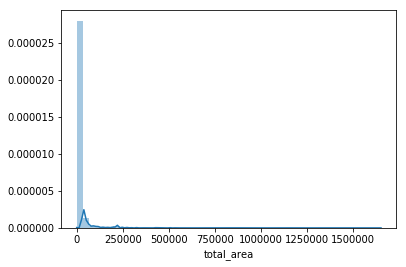

In [171]:
# Verifying the distribution of the variable

sns.distplot(house_df_new['total_area'])
plt.show()

### Inference of distribution

The data has a single distinguishable peak. The histogram shows an abnormaly high number of instances in the total area measures of smaller size, indicating maximum presence of such properties. Also, the data is extremely right skewed indicating presence of outliers.

In [172]:
# Plotting boxplot to detect outliers

data=[(go.Box(x=house_df_new['total_area'],name='total_area',showlegend=True))]
plotly.offline.iplot(data)

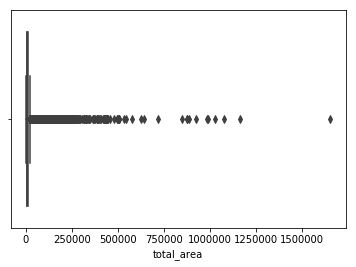

In [173]:
sns.boxplot(house_df_new['total_area'])
plt.show()

### Inference of Suspected outliers

As per boxplot, values > 21942 suggests suspected outliers.

In [174]:
# creating outlier dataframe
total_area_outlier=house_df_new[(house_df_new.total_area>21942)]
total_area_outlier.shape

(2419, 26)

In [175]:
# correlation of total area with price

total_area_outlier['total_area'].corr(house_df_new['price'])

-0.043639054935940266

There are 2419 outlier entries. They have no corelation with price. Hence, they can be removed from the analysis dataframe.

# Outlier Summary

Based on the univariate and bivariate analysis, the following decisions were taken. 

### Outliers to be removed:

1) total_area         (2419 entries)

2) lot_measure15      (2194 entries)

3) room_bed -> Case B (347 entries)

4) lot_measure        (2425 entries)

5) long               (256 entries)

6) coast              (163 entries)

7) condition          (30 entries)

8) yr_renovated       (914 entries)

9) cid                (entire column)



### Outliers decision to be taken based on modelling accuracy:



In [176]:
# With reference to univariate inferences, converting binomial datatypes(coast, furnished) and date datatypes (sold_year,sold_month,yr_renovated) into categorical variable by one-hot coding

house_df_new=pd.get_dummies(house_df_new, columns= ['sold_year','sold_month','yr_renovated','coast','furnished'])
                                                                   

In [177]:
house_df_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Columns: 109 entries, cid to furnished_1
dtypes: float64(4), int64(17), uint8(88)
memory usage: 5.3 MB


In [178]:
house_df_new.head(5)

,cid,price,room_bed,room_bath,living_measure,lot_measure,ceil,sight,condition,quality,...,yr_renovated_2010,yr_renovated_2011,yr_renovated_2012,yr_renovated_2013,yr_renovated_2014,yr_renovated_2015,coast_0,coast_1,furnished_0,furnished_1
0,3034200666,808100,4,3.25,3020,13457,1.0,0,5,9,...,0,0,0,0,0,0,1,0,0,1
1,8731981640,277500,4,2.50,2550,7500,1.0,0,3,8,...,0,0,0,0,0,0,1,0,1,0
2,5104530220,404000,3,2.50,2370,4324,2.0,0,3,8,...,0,0,0,0,0,0,1,0,1,0
3,6145600285,300000,2,1.00,820,3844,1.0,0,4,6,...,0,0,0,0,0,0,1,0,1,0
4,8924100111,699000,2,1.50,1400,4050,1.0,0,4,8,...,0,0,0,0,0,0,1,0,1,0


# Corelation analysis

In [179]:
X=house_df_new.drop('price',axis=1)

In [180]:
X_corr=X.corr()

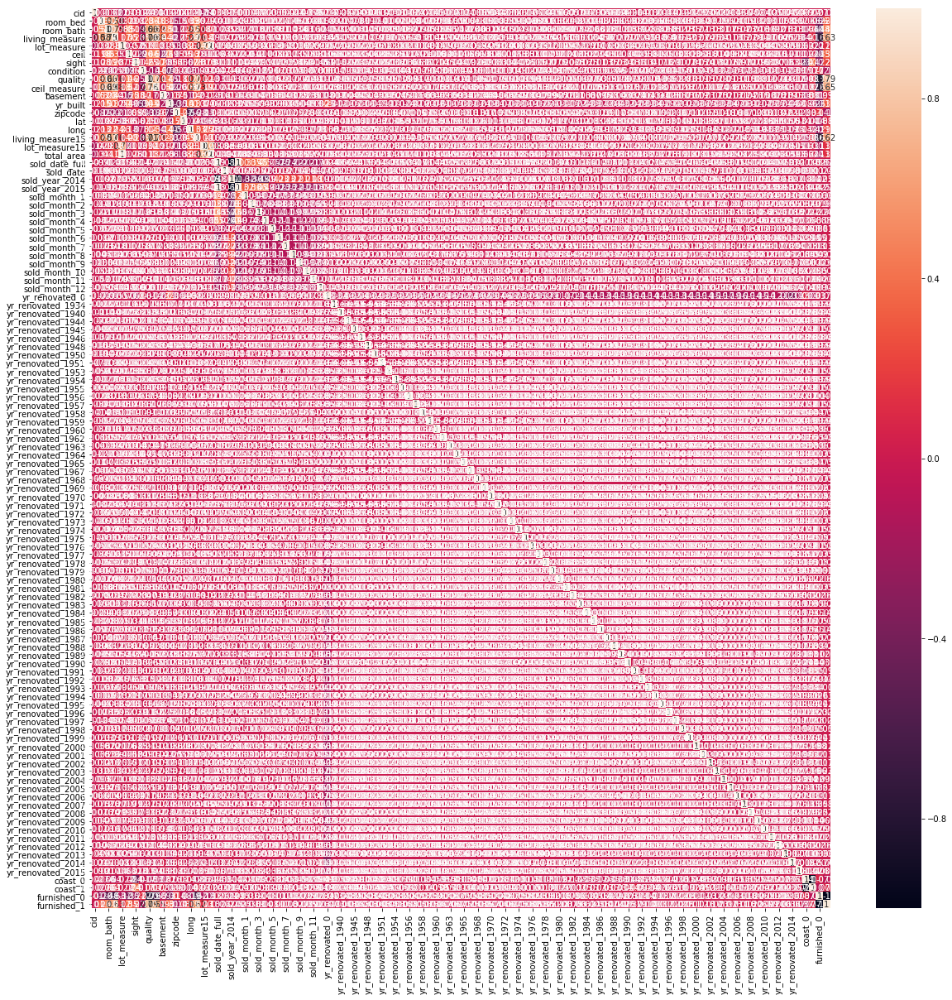

In [181]:
fig, ax = plt.subplots(figsize=(20,20))   
sns.heatmap(X_corr,annot=True)

In [182]:
def get_redundant_pairs(X):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = X.columns
    for i in range(0, X.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(X, n=25):
    au_corr = X.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(X)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

print("Top Absolute Correlations")
print(get_top_abs_correlations(X, 25))

Top Absolute Correlations
furnished_0       furnished_1         1.000000
sold_year_2014    sold_year_2015      1.000000
coast_0           coast_1             1.000000
lot_measure       total_area          0.999763
sold_date_full    sold_year_2014      0.999050
                  sold_year_2015      0.999050
living_measure    ceil_measure        0.876597
quality           furnished_1         0.788621
                  furnished_0         0.788621
living_measure    quality             0.762704
                  living_measure15    0.756420
quality           ceil_measure        0.755923
room_bath         living_measure      0.754665
ceil_measure      living_measure15    0.731870
lot_measure15     total_area          0.719692
lot_measure       lot_measure15       0.718557
quality           living_measure15    0.713202
room_bath         ceil_measure        0.685342
                  quality             0.664983
ceil_measure      furnished_1         0.652383
                  furnished_0     

## Inference

Iot_measure and total_area are very strongly corelated. Likewise ceiling measure and living measure are highly corelated. As there are strong positive corelations between some of the input variables, we can do a PCA to reduce the dimensions

# Unsupervised learning to evaluate the number of clusters using k means clustering - Base model

[2543592459.444574, 1097449012.8419323, 749351845.2740608, 587693147.7088225, 466230288.4653895, 372393521.21129125, 318126134.50746155, 279141838.21687806, 249703467.14668575, 217370438.86874327, 192296754.06323323, 165907546.28857943, 156565974.92430824, 145808632.9930508, 136156702.9259046, 125286940.13631013, 118180221.68544227, 111492759.41272327, 104793464.12143919]


Text(0.5,1,'Selecting k with the Elbow Method')

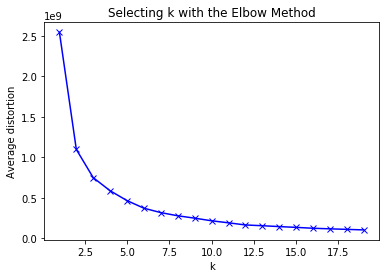

In [183]:
house_df_base=house_df_new.copy()
attributes = house_df_base.drop('price',axis=1)

#Finding optimal no. of clusters
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
clusters=range(1,20)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(attributes)
    prediction=model.predict(attributes)
    meanDistortions.append(sum(np.min(cdist(attributes, model.cluster_centers_, 'euclidean'), axis=1)) / attributes.shape[0])

print (meanDistortions)    
plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')


Using unsupervised learning technique - K means clustering, the number of clusters identified is 4

In [184]:
#  K = 4
final_model=KMeans(n_clusters=4)
final_model.fit(attributes)
prediction=final_model.predict(attributes)

#Append the prediction 
house_df_base["GROUP"] = prediction
print("Groups Assigned : \n")
house_df_base[["price", "GROUP"]].head(5)

Groups Assigned : 



,price,GROUP
0,808100,3
1,277500,2
2,404000,1
3,300000,1
4,699000,2


In [185]:
house_df_base.groupby(by='GROUP',axis=0).count()

,cid,price,room_bed,room_bath,living_measure,lot_measure,ceil,sight,condition,quality,...,yr_renovated_2010,yr_renovated_2011,yr_renovated_2012,yr_renovated_2013,yr_renovated_2014,yr_renovated_2015,coast_0,coast_1,furnished_0,furnished_1
GROUP,,,,,,,,,,,,,,,,,,,,,
0,5827,5827,5827,5827,5827,5827,5827,5827,5827,5827,...,5827,5827,5827,5827,5827,5827,5827,5827,5827,5827
1,3988,3988,3988,3988,3988,3988,3988,3988,3988,3988,...,3988,3988,3988,3988,3988,3988,3988,3988,3988,3988
2,5277,5277,5277,5277,5277,5277,5277,5277,5277,5277,...,5277,5277,5277,5277,5277,5277,5277,5277,5277,5277
3,6521,6521,6521,6521,6521,6521,6521,6521,6521,6521,...,6521,6521,6521,6521,6521,6521,6521,6521,6521,6521


# Base Modelling - Benchmark`

In [186]:
# input and target variable definition

X_base=house_df_new.drop('price',axis=1)
y_base=house_df_new['price']
print("Base X set size:", X_base.shape)
print("Base Y set size:",y_base.shape)
from sklearn.model_selection import train_test_split
X_train_base, X_test_base, y_train_base, y_test_base = train_test_split(X_base, y_base, test_size=0.30, random_state=10)
print("X_train set size:", X_train_base.shape)
print("Y_train set size:",y_train_base.shape)
print("X_train set size:", X_test_base.shape)
print("Y_train set size:",y_test_base.shape)


Base X set size: (21613, 108)
Base Y set size: (21613,)
X_train set size: (15129, 108)
Y_train set size: (15129,)
X_train set size: (6484, 108)
Y_train set size: (6484,)


# Linear Regression - base model

In [187]:
# Linear Regression Model 
from sklearn.linear_model import LinearRegression

In [188]:
base_regression_model = LinearRegression()
base_regression_model.fit(X_train_base, y_train_base)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [189]:
base_reg_train_acc=round((base_regression_model.score(X_train_base,y_train_base)*100),2)
print ('Train model accuracy:' ,base_reg_train_acc,'%')

Train model accuracy: 70.34 %


In [190]:
base_reg_test_acc= round((base_regression_model.score(X_test_base,y_test_base)*100),2)
print ('Test model accuracy:', base_reg_test_acc,'%')

Test model accuracy: 71.11 %


#### With base modeling, Linear Regression yields an accuracy of 71.13 %

In [191]:
# create a panda summary dataframe of results
#data=['Base model','Linear regression',base_reg_train_acc,base_reg_test_acc]
#data=np.vstack(data)
#print(data)
column_head=['Strategy','Modelling method','Train model accuracy','Test model accuracy']
data = {'Strategy': ['Base model'], 'Modelling method': ['Linear regression'],'Train model accuracy': 
    [base_reg_train_acc],'Test model accuracy':[base_reg_test_acc]}
acc_df = pd.DataFrame(data,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11


# Decision Tree Regression - base model

In [192]:
# Base Model - Decision Tree Regression (with base dataframe)

# Decision Tree Regression model

from sklearn.tree import DecisionTreeRegressor

base_dt_model = DecisionTreeRegressor(max_depth=4,random_state=100)
# depth of 4 has been considered since the number of clusters is 4 iidentified through unsupervised learning
base_dt_model.fit(X_train_base,y_train_base)

DecisionTreeRegressor(criterion='mse', max_depth=4, max_features=None,
           max_leaf_nodes=None, min_impurity_decrease=0.0,
           min_impurity_split=None, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           presort=False, random_state=100, splitter='best')

In [193]:
base_dt_train_acc=round((base_dt_model.score(X_train_base,y_train_base)*100),2)
print ('Train model accuracy:' ,base_dt_train_acc,'%')

Train model accuracy: 67.18 %


In [194]:
base_dt_test_acc= round((base_dt_model.score(X_test_base,y_test_base)*100),2)
print ('Test model accuracy:', base_dt_test_acc,'%')

Test model accuracy: 64.06 %


#### With base modeling, Decision Tree Regression yields an accuracy of 64.06% which is lower than Linear Regression, suggesting model tuning is required

In [195]:
# append to accuracy summary table
row_add=['Base model','Decision Tree Regression',base_dt_train_acc,base_dt_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06


# Random Forest Regression - Base model

In [196]:
# Random Forest Regression

from sklearn.ensemble import RandomForestRegressor
base_rtr_model=RandomForestRegressor(max_depth=4,random_state=100)
# depth of 4 has been considered since the number of clusters is 4 iidentified through unsupervised learning
base_rtr_model.fit(X_train_base,y_train_base)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=4,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
           oob_score=False, random_state=100, verbose=0, warm_start=False)

In [197]:
base_rtr_train_acc=round((base_rtr_model.score(X_train_base,y_train_base)*100),2)
print ('Train model accuracy:' ,base_rtr_train_acc,'%')

Train model accuracy: 74.58 %


In [198]:
base_rtr_test_acc= round((base_rtr_model.score(X_test_base,y_test_base)*100),2)
print ('Test model accuracy:', base_rtr_test_acc,'%')

Test model accuracy: 73.92 %


#### With base modeling, Random forest Regression yields an accuracy of 74.56% but requires model tuning

In [199]:
# append to accuracy summary table
row_add=['Base model','Random Forest Regression',base_rtr_train_acc,base_rtr_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92


# KNN Regression - Base model

In [200]:
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from math import sqrt

In [201]:
rmse_val = [] #to store rmse values for different k
for K in range(20):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K)

    model.fit(X_train_base, y_train_base)  #fit the model
    pred=model.predict(X_test_base) #make prediction on test set
    error = sqrt(mean_squared_error(y_test_base,pred)) #calculate rmse
    rmse_val.append(error) #store rmse values
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 312966.12490783486
RMSE value for k=  2 is: 288938.40271902137
RMSE value for k=  3 is: 295034.6354634585
RMSE value for k=  4 is: 297767.5654934192
RMSE value for k=  5 is: 299689.38155476196
RMSE value for k=  6 is: 301302.21556670364
RMSE value for k=  7 is: 302598.91315382946
RMSE value for k=  8 is: 304647.6314277953
RMSE value for k=  9 is: 307392.11326797755
RMSE value for k=  10 is: 310707.16451393405
RMSE value for k=  11 is: 313120.9217263865
RMSE value for k=  12 is: 316043.3360885156
RMSE value for k=  13 is: 318152.3124033499
RMSE value for k=  14 is: 320291.56597014214
RMSE value for k=  15 is: 321789.9057274503
RMSE value for k=  16 is: 323499.1697240751
RMSE value for k=  17 is: 324885.73238530644
RMSE value for k=  18 is: 326274.366652643
RMSE value for k=  19 is: 327737.9518779454
RMSE value for k=  20 is: 328214.4108772502


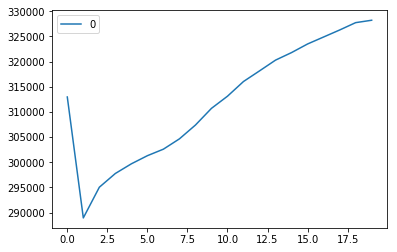

In [202]:
#plotting the rmse values against k values
curve = pd.DataFrame(rmse_val) #elbow curve 
curve.plot()

The knee appears at a k value of 2

In [203]:
base_knn_model = neighbors.KNeighborsRegressor(n_neighbors = 2)
base_knn_model.fit(X_train_base,y_train_base)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
          metric_params=None, n_jobs=None, n_neighbors=2, p=2,
          weights='uniform')

In [204]:
base_knn_train_acc=round((base_knn_model.score(X_train_base,y_train_base)*100),2)
print ('Train model accuracy:' ,base_knn_train_acc,'%')

Train model accuracy: 82.81 %


In [205]:
base_knn_test_acc= round((base_knn_model.score(X_test_base,y_test_base)*100),2)
print ('Test model accuracy:', base_knn_test_acc,'%')

Test model accuracy: 36.08 %


#### With base modeling and k =2, kNN Regression yields an accuracy of 36.14%, denoting it is highly underfit and also denotes the impact of outliers

In [206]:
# append to accuracy summary table
row_add=['Base model','kNN Regression',base_knn_train_acc,base_knn_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08


# Base model - Inference

In Base modelling,  Random Forest regression gives a maximum score of 74.56%. However looking into the train model accuracy of 74.6%, there is a visibility to improve the model through hyperparameter tuning.

Also with kNN regression yielding the maximum train model accuracy, however resulting in the least test accuracy denoting that the impact of outlier is high. Hence, proceeding with Outlier Strategy 1

# Outlier Treatment and Normalizing [Strategy 1] Dataframes - Modelling

In [207]:
# outliers to be removed - grouping and creating a dataframe

house_df_out1=house_df_new.copy()
house_df_out1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Columns: 109 entries, cid to furnished_1
dtypes: float64(4), int64(17), uint8(88)
memory usage: 5.3 MB


In [208]:
# outlier strategy 1
# droping of rows containing the index of outlier elements.
house_df_out1=house_df_out1.drop(total_area_outlier['cid'].index|lot_meas15_outlier['cid'].index|
                                 liv_meas15_outlier['cid'].index|room_bed_outlier_1['cid'].index|
                                 lot_measure_outlier['cid'].index|long_outlier['cid'].index|
                                 coast_outlier['cid'].index|condition_outlier['cid'].index|
                                 yr_renovated_outlier['cid'].index,axis=0)
# dropping 'cid' from the dataframe
house_df_out1=house_df_out1.drop('cid',axis=1)
house_df_out1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17380 entries, 0 to 21612
Columns: 108 entries, price to furnished_1
dtypes: float64(4), int64(16), uint8(88)
memory usage: 4.2 MB


In [209]:
# Normalizing the dataframe to evaluate the spread across the elements in a similar fashion

from scipy.stats import zscore

house_scaled_df_out_1 = house_df_out1.apply(zscore)
house_scaled_df_out_1.isnull().sum()

price                    0
room_bed                 0
room_bath                0
living_measure           0
lot_measure              0
ceil                     0
sight                    0
condition                0
quality                  0
ceil_measure             0
basement                 0
yr_built                 0
zipcode                  0
lat                      0
long                     0
living_measure15         0
lot_measure15            0
total_area               0
sold_date_full           0
sold_date                0
sold_year_2014           0
sold_year_2015           0
sold_month_1             0
sold_month_2             0
sold_month_3             0
sold_month_4             0
sold_month_5             0
sold_month_6             0
sold_month_7             0
sold_month_8             0
                     ...  
yr_renovated_1990    17380
yr_renovated_1991    17380
yr_renovated_1992    17380
yr_renovated_1993    17380
yr_renovated_1994    17380
yr_renovated_1995    17380
y

In [210]:
house_scaled_df_out_1=house_scaled_df_out_1.fillna(0)
house_scaled_df_out_1.isnull().sum()

price                0
room_bed             0
room_bath            0
living_measure       0
lot_measure          0
ceil                 0
sight                0
condition            0
quality              0
ceil_measure         0
basement             0
yr_built             0
zipcode              0
lat                  0
long                 0
living_measure15     0
lot_measure15        0
total_area           0
sold_date_full       0
sold_date            0
sold_year_2014       0
sold_year_2015       0
sold_month_1         0
sold_month_2         0
sold_month_3         0
sold_month_4         0
sold_month_5         0
sold_month_6         0
sold_month_7         0
sold_month_8         0
                    ..
yr_renovated_1990    0
yr_renovated_1991    0
yr_renovated_1992    0
yr_renovated_1993    0
yr_renovated_1994    0
yr_renovated_1995    0
yr_renovated_1996    0
yr_renovated_1997    0
yr_renovated_1998    0
yr_renovated_1999    0
yr_renovated_2000    0
yr_renovated_2001    0
yr_renovate

In [211]:
#convert the numpy array back into a dataframe 

house_scaled_df_out_1 = pd.DataFrame(house_scaled_df_out_1, columns=house_df_out1.columns)
#Evaluating the scaled dataframe

house_scaled_df_out_1.shape

(17380, 108)

In [212]:
X_out_1=house_scaled_df_out_1.drop('price',axis=1)
y_out_1=house_scaled_df_out_1['price']
print("Out 1 X set size:", X_out_1.shape)
print("Out 1 Y set size:",y_out_1.shape)
X_train_out_1, X_test_out_1, y_train_out_1, y_test_out_1 = train_test_split(X_out_1, y_out_1, test_size=0.30, random_state=10)
print("Out 1 X_train set size:", X_train_out_1.shape)
print("Out 1 Y_train set size:",y_train_out_1.shape)
print("Out 1 X_train set size:", X_test_out_1.shape)
print("Out 1 Y_train set size:",y_test_out_1.shape)

Out 1 X set size: (17380, 107)
Out 1 Y set size: (17380,)
Out 1 X_train set size: (12166, 107)
Out 1 Y_train set size: (12166,)
Out 1 X_train set size: (5214, 107)
Out 1 Y_train set size: (5214,)


# Unsupervised learning to evaluate the number of clusters using k means clustering - Outlier 1 model

[6896.82052082793, 5650.617761601047, 4074.644655187844, 3466.4484399519656, 2970.514114376927, 2749.0016037033433, 2511.9124134979716, 2324.756541108095, 2211.5351866517503, 2116.577135240304, 2039.5992071943294, 1947.647412103757, 1908.1851087878713, 1863.057573231057, 1834.611191859948, 1790.6327611383142, 1750.473985563928, 1719.0818395715294, 1682.6664958651925]


Text(0.5,1,'Selecting k with the Elbow Method')

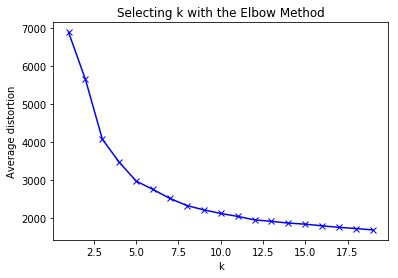

In [213]:
house_df_out1_k=house_df_out1.copy()
attributes = house_df_out1_k.drop('price',axis=1)

#Finding optimal no. of clusters
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
clusters=range(1,20)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(attributes)
    prediction=model.predict(attributes)
    meanDistortions.append(sum(np.min(cdist(attributes, model.cluster_centers_, 'euclidean'), axis=1)) / attributes.shape[0])

print (meanDistortions)    
plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')


With Outlier 1 treated model, the k means values denotes there are 5 clusters in the dataframe

# Linear Regression - Outlier Strategy 1 model

In [214]:
out_1_regression_model = LinearRegression()
out_1_regression_model.fit(X_train_out_1, y_train_out_1)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [215]:
out_1_reg_train_acc=round((out_1_regression_model.score(X_train_out_1,y_train_out_1)*100),2)
print ('Train model accuracy:' ,out_1_reg_train_acc,'%')

Train model accuracy: 68.82 %


In [216]:
out_1_reg_test_acc= round((out_1_regression_model.score(X_test_out_1,y_test_out_1)*100),2)
print ('Test model accuracy:', out_1_reg_test_acc,'%')

Test model accuracy: 69.07 %


With base modeling, Linear Regression yields an accuracy of 69%

In [217]:
# append to accuracy summary table
row_add=['Out 1 model','Linear Regression',out_1_reg_train_acc,out_1_reg_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07


# Decision Tree Regression - Outlier Strategy 1 model

In [218]:
# Decision Tree Regression model

out_1_dt_model = DecisionTreeRegressor(max_depth=5,random_state=100)
# depth of 5 has been considered since the number of clusters is 5 iidentified through unsupervised learning
out_1_dt_model.fit(X_train_out_1,y_train_out_1)

DecisionTreeRegressor(criterion='mse', max_depth=5, max_features=None,
           max_leaf_nodes=None, min_impurity_decrease=0.0,
           min_impurity_split=None, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           presort=False, random_state=100, splitter='best')

In [219]:
out_1_dt_train_acc=round((out_1_dt_model.score(X_train_out_1,y_train_out_1)*100),2)
print ('Train model accuracy:' ,out_1_dt_train_acc,'%')

Train model accuracy: 74.19 %


In [220]:
out_1_dt_test_acc= round((out_1_dt_model.score(X_test_out_1,y_test_out_1)*100),2)
print ('Test model accuracy:', out_1_dt_test_acc,'%')

Test model accuracy: 72.06 %


#### With Outlier 1 strategy modeling, Decision Tree Regression yields an accuracy of 72.04%

In [221]:
# append to accuracy summary table
row_add=['Out 1 model','Decision Tree Regression',out_1_dt_train_acc,out_1_dt_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06


# Random Forest Regression - Outlier 1 strategy model

In [222]:
# Random Forest Regression

from sklearn.ensemble import RandomForestRegressor
out_1_rtr_model=RandomForestRegressor(max_depth=5,random_state=100)
# depth of 5 has been considered since the number of clusters is 5 identified through unsupervised learning
out_1_rtr_model.fit(X_train_out_1,y_train_out_1)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=5,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
           oob_score=False, random_state=100, verbose=0, warm_start=False)

In [223]:
out_1_rtr_train_acc=round((out_1_rtr_model.score(X_train_out_1,y_train_out_1)*100),2)
print ('Train model accuracy:' ,out_1_rtr_train_acc,'%')

Train model accuracy: 77.28 %


In [224]:
out_1_rtr_test_acc= round((out_1_rtr_model.score(X_test_out_1,y_test_out_1)*100),2)
print ('Test model accuracy:', out_1_rtr_test_acc,'%')

Test model accuracy: 75.55 %


#### With base modeling, Random forest Regression yields an accuracy of 75.54%

In [225]:
# append to accuracy summary table
row_add=['Out 1 model','Random Forest Regression',out_1_rtr_train_acc,out_1_rtr_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55


# KNN Regression - Outlier Strategy 1 model

In [226]:
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from math import sqrt

In [227]:
rmse_val = [] #to store rmse values for different k
for K in range(20):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K)

    model.fit(X_train_out_1, y_train_out_1)  #fit the model
    pred=model.predict(X_test_out_1) #make prediction on test set
    error = sqrt(mean_squared_error(y_test_out_1,pred)) #calculate rmse
    rmse_val.append(error) #store rmse values
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 0.6894507171292934
RMSE value for k=  2 is: 0.5919387288680766
RMSE value for k=  3 is: 0.5754919902733622
RMSE value for k=  4 is: 0.5618709935573103
RMSE value for k=  5 is: 0.5631143329298552
RMSE value for k=  6 is: 0.5596198756423308
RMSE value for k=  7 is: 0.5556931447312611
RMSE value for k=  8 is: 0.5569985266757148
RMSE value for k=  9 is: 0.5557495794587379
RMSE value for k=  10 is: 0.5593958561498403
RMSE value for k=  11 is: 0.5623139612295766
RMSE value for k=  12 is: 0.5647923956795411
RMSE value for k=  13 is: 0.5675452697007018
RMSE value for k=  14 is: 0.5703199551617942
RMSE value for k=  15 is: 0.5712735326746745
RMSE value for k=  16 is: 0.5745573052225349
RMSE value for k=  17 is: 0.5758442460362736
RMSE value for k=  18 is: 0.5767069362825195
RMSE value for k=  19 is: 0.5775604119049594
RMSE value for k=  20 is: 0.5802797681347965


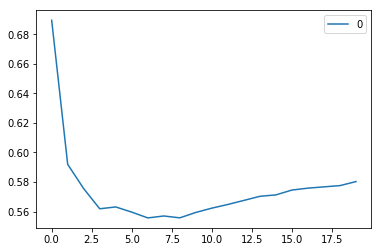

In [228]:
#plotting the rmse values against k values
curve = pd.DataFrame(rmse_val) #elbow curve 
curve.plot()

The knee appears at a k value of 3

In [229]:
out_1_knn_model = neighbors.KNeighborsRegressor(n_neighbors = 3)
out_1_knn_model.fit(X_train_out_1,y_train_out_1)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
          metric_params=None, n_jobs=None, n_neighbors=3, p=2,
          weights='uniform')

In [230]:
out_1_knn_train_acc=round((out_1_knn_model.score(X_train_out_1,y_train_out_1)*100),2)
print ('Train model accuracy:' ,out_1_knn_train_acc,'%')

Train model accuracy: 83.36 %


In [231]:
out_1_knn_test_acc= round((out_1_knn_model.score(X_test_out_1,y_test_out_1)*100),2)
print ('Test model accuracy:', out_1_knn_test_acc,'%')

Test model accuracy: 65.88 %


#### With outlier 1 modeling, kNN Regression yields an accuracy of 65.9%

In [232]:
# append to accuracy summary table
row_add=['Out 1 model','kNN Regression',out_1_knn_train_acc,out_1_knn_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array)
acc_df

,0,1,2,3
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88


## Hyperparameter tuning

In [233]:
from sklearn.model_selection import RandomizedSearchCV

from pprint import pprint

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 1, stop = 100, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

pprint(random_grid)

{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [1, 12, 23, 34, 45, 56, 67, 78, 89, 100]}


In [234]:
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestRegressor(random_state = 42)
# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=random_grid,
                              n_iter = 100, scoring='neg_mean_absolute_error', 
                              cv = 3, verbose=2, random_state=42, n_jobs=-1,
                              return_train_score=True)

# Fit the random search model
rf_random.fit(X_train_out_1, y_train_out_1);

Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 300 out of 300 | elapsed:  6.4min finished


In [235]:
rf_random.best_params_

{'n_estimators': 100,
 'min_samples_split': 2,
 'min_samples_leaf': 2,
 'max_features': 'auto',
 'max_depth': 90,
 'bootstrap': True}

In [236]:
randomcv_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
randomcv_rtr_model.fit(X_train_out_1,y_train_out_1)

RandomForestRegressor(bootstrap='True', criterion='mse', max_depth=90,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=2, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None,
           oob_score=False, random_state=100, verbose=0, warm_start=False)

In [237]:
randomcv_rtr_train_acc=round((randomcv_rtr_model.score(X_train_out_1,y_train_out_1)*100),2)
print ('Train model accuracy:' ,randomcv_rtr_train_acc,'%')

Train model accuracy: 97.35 %


In [238]:
randomcv_rtr_test_acc= round((randomcv_rtr_model.score(X_test_out_1,y_test_out_1)*100),2)
print ('Test model accuracy:', randomcv_rtr_test_acc,'%')

Test model accuracy: 88.13 %


#### With random search CV modeling, Random forest Regression yields an accuracy of 88%

In [239]:
# append to accuracy summary table
row_add=['Out 1 model','Randomsearch CV Forest Regression',randomcv_rtr_train_acc,randomcv_rtr_test_acc]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88
8,Out 1 model,Randomsearch CV Forest Regression,97.35,88.13


In [240]:
#kfold validation on Random Forest Regression - Outlier Strategy 1

from sklearn.model_selection import KFold 
Train_scores_1 = []
Test_scores_1 = []
cv = KFold(n_splits=10, random_state=42, shuffle=True)
for train_index, test_index in cv.split(X_train_out_1):
    print("Train Index: ", train_index, "\n")
    print("Test Index: ", test_index,"\n")
    X_train_CV_out_1 = X_out_1.iloc[train_index]
    X_train_CV_out_1, X_test_CV_out_1, y_train_CV_out_1, y_test_CV_out_1 = X_out_1.iloc[train_index],X_out_1.iloc[test_index],y_out_1.iloc[train_index], y_out_1.iloc[test_index]
    kfold_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
    kfold_rtr_model.fit(X_train_CV_out_1,y_train_CV_out_1)
    kfold_rtr_train_acc=round((kfold_rtr_model.score(X_train_CV_out_1,y_train_CV_out_1)*100),2)
    print ('Train model accuracy:' ,kfold_rtr_train_acc,'%',"\n")
    kfold_rtr_test_acc= round((kfold_rtr_model.score(X_test_CV_out_1,y_test_CV_out_1)*100),2)
    print ('Test model accuracy:', kfold_rtr_test_acc,'%',"\n")
    Train_scores_1.append(kfold_rtr_train_acc)
    Test_scores_1.append(kfold_rtr_test_acc)



Train Index:  [    0     1     2 ... 12162 12163 12165] 

Test Index:  [   14    19    31 ... 12122 12123 12164] 

Train model accuracy: 97.49 % 

Test model accuracy: 86.56 % 

Train Index:  [    1     2     4 ... 12163 12164 12165] 

Test Index:  [    0     3     8 ... 12131 12138 12157] 

Train model accuracy: 97.44 % 

Test model accuracy: 87.97 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   10    23    29 ... 12119 12133 12150] 

Train model accuracy: 97.52 % 

Test model accuracy: 87.63 % 

Train Index:  [    0     1     2 ... 12162 12163 12164] 

Test Index:  [   12    20    30 ... 12159 12160 12165] 

Train model accuracy: 97.53 % 

Test model accuracy: 87.71 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   26    27    51 ... 12145 12151 12161] 

Train model accuracy: 97.5 % 

Test model accuracy: 88.37 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   15    28    34 ... 12134 12155 12158

In [241]:
Train_mean_1=np.mean(Train_scores_1)
Test_mean_1=np.mean(Test_scores_1)


Train_sc_pl_1 = pd.DataFrame(Train_scores_1)
print("Train scores:",Train_scores_1,"\n")

Test_sc_pl_1 = pd.DataFrame(Test_scores_1)
print("Test scores:",Test_scores_1,"\n")

print("Average Train score:",Train_mean_1,"\n")
print("Average Test score:",Test_mean_1,"\n")

Train scores: [97.49, 97.44, 97.52, 97.53, 97.5, 97.46, 97.44, 97.43, 97.54, 97.38] 

Test scores: [86.56, 87.97, 87.63, 87.71, 88.37, 88.73, 86.4, 88.1, 84.83, 88.7] 

Average Train score: 97.47299999999998 

Average Test score: 87.50000000000001 



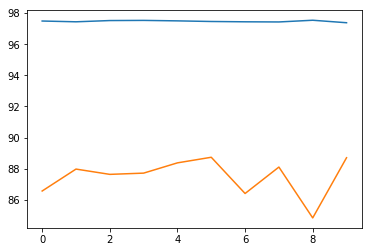

In [242]:
plt.plot(Train_sc_pl_1)
plt.plot(Test_sc_pl_1)
plt.show()

In [243]:
# append to accuracy summary table
row_add=['Out 1 model','kfold Random Forest Regression (Mean)',round(Train_mean_1,2),round(Test_mean_1,2)]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88
8,Out 1 model,Randomsearch CV Forest Regression,97.35,88.13
9,Out 1 model,kfold Random Forest Regression (Mean),97.47,87.5


In [244]:
# Gradient Boosting
from sklearn.ensemble import GradientBoostingRegressor

Train_scores_gb = []
Test_scores_gb = []




cv = KFold(n_splits=10, random_state=42, shuffle=True)
for train_index, test_index in cv.split(X_train_out_1):
    print("Train Index: ", train_index, "\n")
    print("Test Index: ", test_index,"\n")
    X_train_CV_out_1, X_test_CV_out_1, y_train_CV_out_1, y_test_CV_out_1 = X_out_1.iloc[train_index],X_out_1.iloc[test_index],y_out_1.iloc[train_index], y_out_1.iloc[test_index]
    gb_model = GradientBoostingRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100)
    gb_model.fit(X_train_CV_out_1,y_train_CV_out_1)
    gb_model_train_acc=round((gb_model.score(X_train_CV_out_1,y_train_CV_out_1)*100),2)
    print ('Train model accuracy:' ,gb_model_train_acc,'%',"\n")
    gb_model_test_acc= round((gb_model.score(X_test_CV_out_1,y_test_CV_out_1)*100),2)
    print ('Test model accuracy:', gb_model_test_acc,'%',"\n")

    Train_scores_gb.append(gb_model_train_acc)
    Test_scores_gb.append(gb_model_test_acc)


Train Index:  [    0     1     2 ... 12162 12163 12165] 

Test Index:  [   14    19    31 ... 12122 12123 12164] 

Train model accuracy: 100.0 % 

Test model accuracy: 81.18 % 

Train Index:  [    1     2     4 ... 12163 12164 12165] 

Test Index:  [    0     3     8 ... 12131 12138 12157] 

Train model accuracy: 100.0 % 

Test model accuracy: 84.98 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   10    23    29 ... 12119 12133 12150] 

Train model accuracy: 100.0 % 

Test model accuracy: 83.69 % 

Train Index:  [    0     1     2 ... 12162 12163 12164] 

Test Index:  [   12    20    30 ... 12159 12160 12165] 

Train model accuracy: 100.0 % 

Test model accuracy: 83.6 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   26    27    51 ... 12145 12151 12161] 

Train model accuracy: 100.0 % 

Test model accuracy: 86.45 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   15    28    34 ... 12134 12155 12158

In [245]:
Train_mean_gb=np.mean(Train_scores_gb)
Test_mean_gb=np.mean(Test_scores_gb)


Train_sc_pl_gb = pd.DataFrame(Train_scores_gb)
print("Train scores:",Train_scores_gb,"\n")

Test_sc_pl_gb = pd.DataFrame(Test_scores_gb)
print("Test scores:",Test_scores_gb,"\n")

print("Average Train score:",Train_mean_gb,"\n")
print("Average Test score:",Test_mean_gb,"\n")

Train scores: [100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0] 

Test scores: [81.18, 84.98, 83.69, 83.6, 86.45, 85.65, 81.82, 83.95, 81.8, 86.0] 

Average Train score: 100.0 

Average Test score: 83.912 



In [246]:
# append to accuracy summary table
row_add=['Out 1 model','kfold Gradient Boosting Regression(mean)',round(Train_mean_gb,2),round(Test_mean_gb,2)]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array)
acc_df

,0,1,2,3
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88
8,Out 1 model,Randomsearch CV Forest Regression,97.35,88.13
9,Out 1 model,kfold Random Forest Regression (Mean),97.47,87.5


# Outlier Treatment and Normalizing [Strategy 2] Dataframes - Modelling

In [247]:
# Outlier Strategy 2
# creating new dataframe with suspected outliers to be removed based on model accuracy

house_df_out2=house_df_new.copy()
house_df_out2=house_df_out2.drop(total_area_outlier['cid'].index|lot_meas15_outlier['cid'].index|
                                 liv_meas15_outlier['cid'].index|room_bed_outlier_1['cid'].index|
                                 lot_measure_outlier['cid'].index|long_outlier['cid'].index|
                                 coast_outlier['cid'].index|condition_outlier['cid'].index|
                                 yr_renovated_outlier['cid'].index|room_bath_outlier['cid'].index|
                                 room_bed_outlier['cid'].index|living_measure_outlier['cid'].index|
                                 sight_outlier['cid'].index|quality_outlier['cid'].index|
                                 room_bath_outlier['cid'].index,axis=0)
# dropping 'cid' from the dataframe
house_df_out2=house_df_out2.drop('cid',axis=1)
house_df_out2.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 15180 entries, 0 to 21612
Columns: 108 entries, price to furnished_1
dtypes: float64(4), int64(16), uint8(88)
memory usage: 3.7 MB


In [248]:
# Normalizing the dataframe to evaluate the spread across the elements in a similar fashion

house_scaled_df_out_2 = house_df_out2.apply(zscore)
house_scaled_df_out_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15180 entries, 0 to 21612
Columns: 108 entries, price to furnished_1
dtypes: float64(108)
memory usage: 12.6 MB


In [249]:
house_scaled_df_out_2=house_scaled_df_out_2.fillna(0)

In [250]:
#convert the numpy array back into a dataframe 

house_scaled_df_out_2 = pd.DataFrame(house_scaled_df_out_2, columns=house_df_out2.columns)
#Evaluating the scaled dataframe

house_scaled_df_out_2.shape

(15180, 108)

In [251]:
X_out_2=house_scaled_df_out_2.drop('price',axis=1)
y_out_2=house_scaled_df_out_2['price']
print("Out 2 X set size:", X_out_2.shape)
print("Out 2 Y set size:",y_out_2.shape)
X_train_out_2, X_test_out_2, y_train_out_2, y_test_out_2 = train_test_split(X_out_2, y_out_2, test_size=0.30, random_state=10)
print("Out 2 X_train set size:", X_train_out_2.shape)
print("Out 2 Y_train set size:",y_train_out_2.shape)
print("Out 2 X_train set size:", X_test_out_2.shape)
print("Out 2 Y_train set size:",y_test_out_2.shape)

Out 2 X set size: (15180, 107)
Out 2 Y set size: (15180,)
Out 2 X_train set size: (10626, 107)
Out 2 Y_train set size: (10626,)
Out 2 X_train set size: (4554, 107)
Out 2 Y_train set size: (4554,)


In [252]:
# kfold Random Forest Regression with Outlier Strategy 2

Train_scores_2 = []
Test_scores_2 = []
cv = KFold(n_splits=10, random_state=42, shuffle=True)
for train_index, test_index in cv.split(X_train_out_2):
    print("Train Index: ", train_index, "\n")
    print("Test Index: ", test_index,"\n")
    X_train_CV_out_2 = X_out_2.iloc[train_index]
    X_train_CV_out_2, X_test_CV_out_2, y_train_CV_out_2, y_test_CV_out_2 = X_out_2.iloc[train_index],X_out_2.iloc[test_index],y_out_2.iloc[train_index], y_out_2.iloc[test_index]
    kfold_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
    kfold_rtr_model.fit(X_train_CV_out_2,y_train_CV_out_2)
    kfold_rtr_train_acc=round((kfold_rtr_model.score(X_train_CV_out_2,y_train_CV_out_2)*100),2)
    print ('Train model accuracy:' ,kfold_rtr_train_acc,'%',"\n")
    kfold_rtr_test_acc= round((kfold_rtr_model.score(X_test_CV_out_2,y_test_CV_out_2)*100),2)
    print ('Test model accuracy:', kfold_rtr_test_acc,'%',"\n")
    Train_scores_2.append(kfold_rtr_train_acc)
    Test_scores_2.append(kfold_rtr_test_acc)



Train Index:  [    0     1     2 ... 10623 10624 10625] 

Test Index:  [    3    14    29 ... 10615 10616 10620] 

Train model accuracy: 97.34 % 

Test model accuracy: 87.61 % 

Train Index:  [    1     2     3 ... 10622 10623 10625] 

Test Index:  [    0     8    10 ... 10600 10619 10624] 

Train model accuracy: 97.46 % 

Test model accuracy: 85.5 % 

Train Index:  [    0     1     2 ... 10623 10624 10625] 

Test Index:  [   12    17    20 ... 10571 10604 10613] 

Train model accuracy: 97.45 % 

Test model accuracy: 85.2 % 

Train Index:  [    0     1     2 ... 10623 10624 10625] 

Test Index:  [   26    41    48 ... 10579 10586 10596] 

Train model accuracy: 97.37 % 

Test model accuracy: 87.83 % 

Train Index:  [    0     1     2 ... 10622 10623 10624] 

Test Index:  [   15    27    28 ... 10590 10610 10625] 

Train model accuracy: 97.35 % 

Test model accuracy: 88.14 % 

Train Index:  [    0     1     3 ... 10623 10624 10625] 

Test Index:  [    2    43    53 ... 10598 10605 10622]

In [253]:
Train_mean_2=np.mean(Train_scores_2)
Test_mean_2=np.mean(Test_scores_2)


Train_sc_pl_2 = pd.DataFrame(Train_scores_2)
print("Train scores:",Train_scores_2,"\n")

Test_sc_pl_2 = pd.DataFrame(Test_scores_2)
print("Test scores:",Test_scores_2,"\n")

print("Average Train score:",Train_mean_2,"\n")
print("Average Test score:",Test_mean_2,"\n")

Train scores: [97.34, 97.46, 97.45, 97.37, 97.35, 97.39, 97.38, 97.4, 97.29, 97.31] 

Test scores: [87.61, 85.5, 85.2, 87.83, 88.14, 86.9, 86.35, 84.48, 88.87, 87.6] 

Average Train score: 97.374 

Average Test score: 86.848 



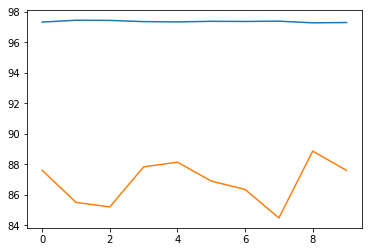

In [254]:
plt.plot(Train_sc_pl_2)
plt.plot(Test_sc_pl_2)
plt.show()

In [255]:
# append to accuracy summary table
row_add=['Out 2 model','kfold Random Forest Regression (Mean)',round(Train_mean_2,2),round(Test_mean_2,2)]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88
8,Out 1 model,Randomsearch CV Forest Regression,97.35,88.13
9,Out 1 model,kfold Random Forest Regression (Mean),97.47,87.5


In [256]:
# kfold Random Forest Regression with Base Dataframe 

Train_scores_base = []
Test_scores_base = []
cv = KFold(n_splits=10, random_state=42, shuffle=True)
for train_index, test_index in cv.split(X_train_base):
    print("Train Index: ", train_index, "\n")
    print("Test Index: ", test_index,"\n")
    X_train_CV_base = X_base.iloc[train_index]
    X_train_CV_base, X_test_CV_base, y_train_CV_base, y_test_CV_base = X_base.iloc[train_index],X_base.iloc[test_index],y_base.iloc[train_index], y_base.iloc[test_index]
    kfold_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
    kfold_rtr_model.fit(X_train_CV_base,y_train_CV_base)
    kfold_rtr_train_acc=round((kfold_rtr_model.score(X_train_CV_base,y_train_CV_base)*100),2)
    print ('Train model accuracy:' ,kfold_rtr_train_acc,'%',"\n")
    kfold_rtr_test_acc= round((kfold_rtr_model.score(X_test_CV_base,y_test_CV_base)*100),2)
    print ('Test model accuracy:', kfold_rtr_test_acc,'%',"\n")
    Train_scores_base.append(kfold_rtr_train_acc)
    Test_scores_base.append(kfold_rtr_test_acc)



Train Index:  [    0     1     2 ... 15124 15125 15126] 

Test Index:  [    8    14    19 ... 15123 15127 15128] 

Train model accuracy: 97.47 % 

Test model accuracy: 86.58 % 

Train Index:  [    0     1     2 ... 15126 15127 15128] 

Test Index:  [    3    15    33 ... 15082 15098 15115] 

Train model accuracy: 97.34 % 

Test model accuracy: 86.81 % 

Train Index:  [    1     2     3 ... 15126 15127 15128] 

Test Index:  [    0    17    36 ... 15086 15110 15113] 

Train model accuracy: 97.4 % 

Test model accuracy: 88.29 % 

Train Index:  [    0     1     2 ... 15126 15127 15128] 

Test Index:  [   10    23    29 ... 15090 15111 15122] 

Train model accuracy: 97.44 % 

Test model accuracy: 87.42 % 

Train Index:  [    0     1     2 ... 15126 15127 15128] 

Test Index:  [   12    20    28 ... 15114 15121 15124] 

Train model accuracy: 97.4 % 

Test model accuracy: 87.75 % 

Train Index:  [    0     1     2 ... 15126 15127 15128] 

Test Index:  [   26    66    69 ... 15074 15104 15107]

In [257]:
Train_mean_base=np.mean(Train_scores_base)
Test_mean_base=np.mean(Test_scores_base)


Train_sc_pl_base = pd.DataFrame(Train_scores_base)
print("Train scores:",Train_scores_base,"\n")

Test_sc_pl_base = pd.DataFrame(Test_scores_base)
print("Test scores:",Test_scores_base,"\n")

print("Average Train score:",Train_mean_base,"\n")
print("Average Test score:",Test_mean_base,"\n")

Train scores: [97.47, 97.34, 97.4, 97.44, 97.4, 97.53, 97.47, 97.56, 97.38, 97.41] 

Test scores: [86.58, 86.81, 88.29, 87.42, 87.75, 87.66, 85.64, 85.52, 87.07, 88.69] 

Average Train score: 97.44 

Average Test score: 87.143 



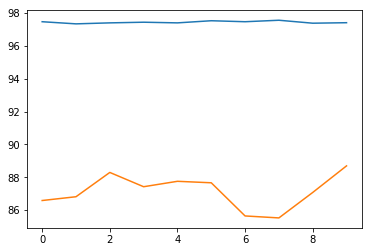

In [258]:
plt.plot(Train_sc_pl_base)
plt.plot(Test_sc_pl_base)
plt.show()

In [259]:
# append to accuracy summary table
row_add=['Base model','kfold Random Forest Regression (Mean)',round(Train_mean_base,2),round(Test_mean_base,2)]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88
8,Out 1 model,Randomsearch CV Forest Regression,97.35,88.13
9,Out 1 model,kfold Random Forest Regression (Mean),97.47,87.5


# Feature importance applied to Out 1 model - kfold Random Forest Regression

In [260]:
kfold_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
kfold_rtr_model.fit(X_train_CV_out_1,y_train_CV_out_1)

feature_importances = pd.DataFrame(kfold_rtr_model.feature_importances_,
                                   index = X_train_CV_out_1.columns,
                                    columns=['importance']).sort_values('importance', ascending=False)
feature_importances.head(15)

,importance
lat,0.266647
living_measure,0.188160
furnished_0,0.114022
quality,0.106895
furnished_1,0.098641
long,0.065880
living_measure15,0.030032
yr_built,0.026970
ceil_measure,0.019237
zipcode,0.014880


In [261]:
# retaining only the top 15 features in the dataframe
house_df_fimp=house_df_out1.copy()
house_df_fimp.shape



(17380, 108)

In [262]:
house_df_fimp=house_df_fimp[['lat','living_measure','furnished_0','quality','furnished_1','long','living_measure15',
          'yr_built','ceil_measure','zipcode','lot_measure15','sold_date_full','sight','total_area','sold_date','price']]
house_df_fimp.shape

(17380, 16)

In [263]:
# creating input and output variables

X_imp=house_df_fimp.drop('price',axis=1)
y_imp=house_df_fimp['price']
print("Feature improved X set size:", X_imp.shape)
print("Feature improved Y set size:",y_imp.shape)

X_train_imp, X_test_imp, y_train_imp, y_test_imp = train_test_split(X_imp, y_imp, test_size=0.30, random_state=10)
print("X_train set size:", X_train_imp.shape)
print("Y_train set size:",y_train_imp.shape)
print("X_train set size:", X_test_imp.shape)
print("Y_train set size:",y_test_imp.shape)

Feature improved X set size: (17380, 15)
Feature improved Y set size: (17380,)
X_train set size: (12166, 15)
Y_train set size: (12166,)
X_train set size: (5214, 15)
Y_train set size: (5214,)


In [264]:
# kfold Random Forest Regression with feature importance applied to Outlier Strategy 1 

Train_scores_1_imp = []
Test_scores_1_imp = []
cv = KFold(n_splits=10, random_state=42, shuffle=True)
for train_index, test_index in cv.split(X_train_imp):
    print("Train Index: ", train_index, "\n")
    print("Test Index: ", test_index,"\n")
    X_train_CV_out_1_imp = X_imp.iloc[train_index]
    X_train_CV_out_1_imp, X_test_CV_out_1_imp, y_train_CV_out_1_imp, y_test_CV_out_1_imp = X_imp.iloc[train_index],X_imp.iloc[test_index],y_imp.iloc[train_index], y_imp.iloc[test_index]
    kfold_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
    kfold_rtr_model.fit(X_train_CV_out_1_imp,y_train_CV_out_1_imp)
    kfold_rtr_imp_train_acc=round((kfold_rtr_model.score(X_train_CV_out_1_imp,y_train_CV_out_1_imp)*100),2)
    print ('Train model accuracy:' ,kfold_rtr_imp_train_acc,'%',"\n")
    kfold_rtr_imp_test_acc= round((kfold_rtr_model.score(X_test_CV_out_1_imp,y_test_CV_out_1_imp)*100),2)
    print ('Test model accuracy:', kfold_rtr_imp_test_acc,'%',"\n")
    Train_scores_1_imp.append(kfold_rtr_imp_train_acc)
    Test_scores_1_imp.append(kfold_rtr_imp_test_acc)



Train Index:  [    0     1     2 ... 12162 12163 12165] 

Test Index:  [   14    19    31 ... 12122 12123 12164] 

Train model accuracy: 97.43 % 

Test model accuracy: 86.95 % 

Train Index:  [    1     2     4 ... 12163 12164 12165] 

Test Index:  [    0     3     8 ... 12131 12138 12157] 

Train model accuracy: 97.4 % 

Test model accuracy: 87.88 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   10    23    29 ... 12119 12133 12150] 

Train model accuracy: 97.49 % 

Test model accuracy: 87.17 % 

Train Index:  [    0     1     2 ... 12162 12163 12164] 

Test Index:  [   12    20    30 ... 12159 12160 12165] 

Train model accuracy: 97.49 % 

Test model accuracy: 87.4 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   26    27    51 ... 12145 12151 12161] 

Train model accuracy: 97.47 % 

Test model accuracy: 88.16 % 

Train Index:  [    0     1     2 ... 12163 12164 12165] 

Test Index:  [   15    28    34 ... 12134 12155 12158]

In [265]:
Train_mean_1_imp=np.mean(Train_scores_1_imp)
Test_mean_1_imp=np.mean(Test_scores_1_imp)


Train_sc_pl_1_imp = pd.DataFrame(Train_scores_1_imp)
print("Train scores:",Train_scores_1_imp,"\n")

Test_sc_pl_1_imp = pd.DataFrame(Test_scores_1_imp)
print("Test scores:",Test_scores_1_imp,"\n")

print("Average Train score:",Train_mean_1_imp,"\n")
print("Average Test score:",Test_mean_1_imp,"\n")

Train scores: [97.43, 97.4, 97.49, 97.49, 97.47, 97.41, 97.38, 97.42, 97.52, 97.34] 

Test scores: [86.95, 87.88, 87.17, 87.4, 88.16, 88.38, 87.29, 87.95, 84.51, 88.72] 

Average Train score: 97.435 

Average Test score: 87.441 



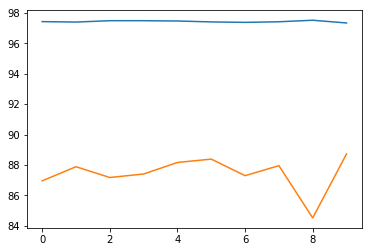

In [266]:
plt.plot(Train_sc_pl_1_imp)
plt.plot(Test_sc_pl_1_imp)
plt.show()

In [267]:
# append to accuracy summary table
row_add=['Out 1 model','feature imp kfold Random Forest Regression (Mean)',round(Train_mean_1_imp,2),round(Test_mean_1_imp,2)]
np_array=acc_df.values
np_array=np.vstack((np_array,row_add))
acc_df=pd.DataFrame(np_array,columns=column_head)
acc_df

,Strategy,Modelling method,Train model accuracy,Test model accuracy
0,Base model,Linear regression,70.34,71.11
1,Base model,Decision Tree Regression,67.18,64.06
2,Base model,Random Forest Regression,74.58,73.92
3,Base model,kNN Regression,82.81,36.08
4,Out 1 model,Linear Regression,68.82,69.07
5,Out 1 model,Decision Tree Regression,74.19,72.06
6,Out 1 model,Random Forest Regression,77.28,75.55
7,Out 1 model,kNN Regression,83.36,65.88
8,Out 1 model,Randomsearch CV Forest Regression,97.35,88.13
9,Out 1 model,kfold Random Forest Regression (Mean),97.47,87.5


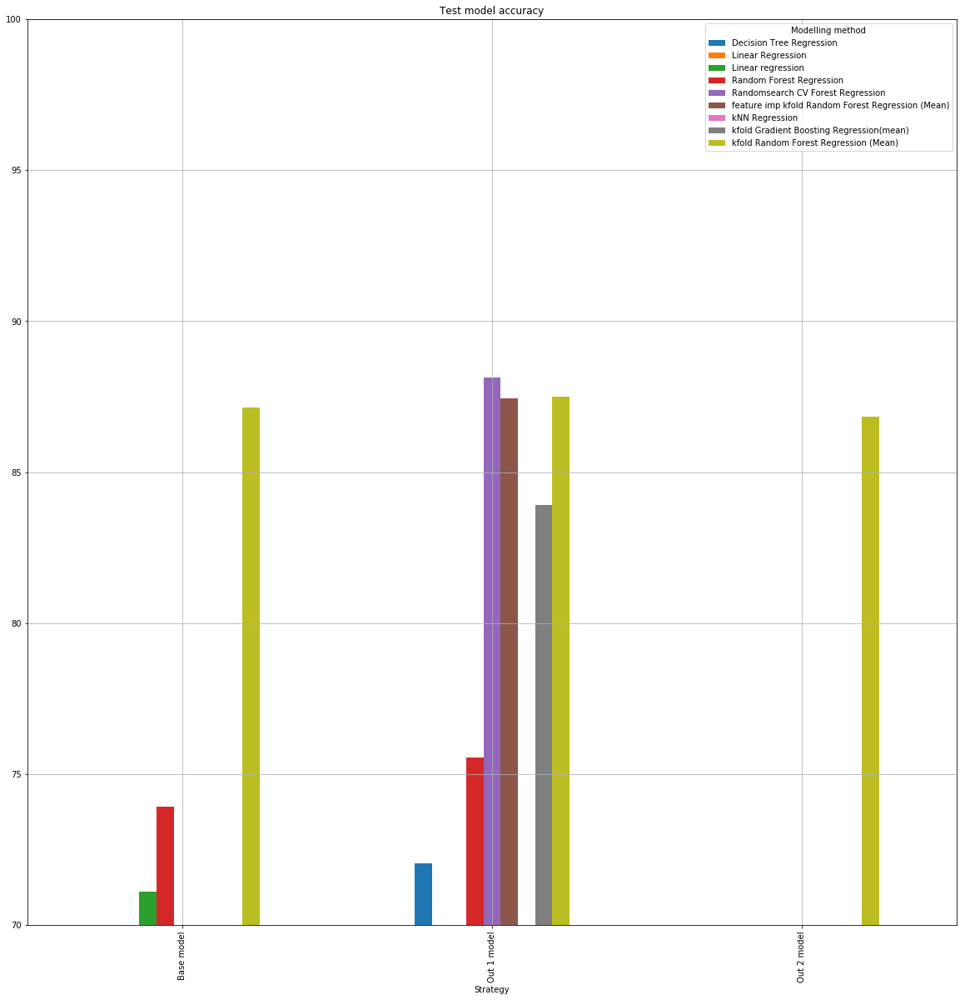

In [268]:
acc_df['Train model accuracy'],acc_df['Test model accuracy']=acc_df['Train model accuracy'].astype('float64'),acc_df['Test model accuracy'].astype('float64')

acc_df.pivot(index="Strategy",columns="Modelling method",values="Test model accuracy").plot(kind='bar',title="Test model accuracy",ylim=[70,100],yticks=[70,75,80,85,90,95,100],grid=True,figsize=(20,20))

# Project Inference:

As seen in the above summary graph, the best benchmark in the base modeling is by kfold Random forest Regression model (10 folds) with a mean test accuracy of 87.14%.

With outlier strategy 1, Random search CV modeling methodlogy [3 folds for each of 100 candidates, totalling 300 fits] has resulted in the best overall accuracy of 88.13%. 

However, to elimiate bias, kfold Random forest regression with 10 folds was performed on the outlier strategy 1 resulted in a mean test accuracy of 87.5%. 

Feature importance on this methodology was performed to reduce the overall dimensions to 15, however there was no improvment observed in the modeling accuracy. Yet, considering the reduced computational effort required, this method would be adopted for the production model.

# Project Conclusion:

With EDA on the subject dataframe, key insights were drawn to the target variable 'Price'. Also, two outlier Strategies were formulated to deal with increasing the modeling accuracy. The absolute target accuracy was decided to by 85 to 90%.

Post which, the base dataframe was evalauted against different regression alogorithms and ensemble algorithms to set the modeling benchmark.

Each of the outlier strategy was evalauted for the various algorithms, and the best performing algorithm was subjected to hyper paratemeter tuning and kfold cross validation to improve the modeling accuracy. Finally feature importance was applicated to the best performing model:

##### kfold Random Forest regression with feature importance on Outlier Strategy 1

##### Best mean accuracy: 87.44%

In [269]:
import pickle

In [272]:
# Dump the feature engineered dataframe structure with Pickle
def feat_extract(dataframe):
    #feature engineering steps
    house_df_new=dataframe.copy()
    house_df_new['sold_date_full']=house_df_new['dayhours'].str[:8].astype('int64')
    house_df_new['sold_date']=house_df_new['dayhours'].str[6:8].astype('int64')
    house_df_new=pd.get_dummies(house_df_new, columns= ['furnished'])
    house_df_fimp=house_df_new[['lat','living_measure','furnished_0','quality','furnished_1','long','living_measure15',
          'yr_built','ceil_measure','zipcode','lot_measure15','sold_date_full','sight','total_area','sold_date','price']]
    #dump in pickle model
    pickle.dump(house_df_fimp,open("feature_engg.pkl","wb"))
    return house_df_fimp
feat_extract(house_df)

,lat,living_measure,furnished_0,quality,furnished_1,long,living_measure15,yr_built,ceil_measure,zipcode,lot_measure15,sold_date_full,sight,total_area,sold_date,price
0,47.7174,3020,0,9,1,-122.336,2120,1956,3020,98133,7553,20141107,0,16477,7,808100
1,47.3165,2550,1,8,0,-122.386,2260,1976,1750,98023,8800,20141204,0,10050,4,277500
2,47.3515,2370,1,8,0,-121.999,2370,2006,2370,98038,4348,20150420,0,6694,20,404000
3,47.7049,820,1,6,0,-122.349,1520,1916,820,98133,3844,20140529,0,4664,29,300000
4,47.6768,1400,1,8,0,-122.269,1900,1954,1400,98115,5940,20150424,0,5450,24,699000
5,47.5279,2050,0,9,1,-122.161,2410,1989,2050,98059,10172,20140715,0,13740,15,585000
6,47.7311,1480,1,7,0,-122.353,1480,1954,1480,98133,6360,20141201,0,7840,1,465000
7,47.7592,2100,1,7,0,-122.230,1610,1949,1220,98028,15999,20140829,0,69369,29,480000
8,47.6370,2600,1,8,0,-122.371,2050,1953,1400,98119,3505,20140707,2,7400,7,780000
9,47.3437,1130,1,7,0,-122.316,1540,1969,1130,98003,7379,20140918,0,8530,18,215000


In [273]:
def evaluate_model(dataframe):
    #input and output variable assignment
    X=dataframe.drop('price',axis=1)
    y=dataframe['price']
    # predict using model
    from sklearn.ensemble import RandomForestRegressor 
    kfold_rtr_model=RandomForestRegressor(n_estimators=100,min_samples_split=2,min_samples_leaf=2,max_features='auto',
                                         max_depth=90,random_state=100,bootstrap='True')
    kfold_rtr_model.fit(X,y)
    accuracy = round((kfold_rtr_model.score(X,y)*100),2)
    #Productionize model
    pickle.dump(kfold_rtr_model, open('model.pkl', 'wb'))
     
    return accuracy
evaluate_model(house_df_fimp)

97.51